# contenu 
### -statestiques générales
### -carte choropleth 
### -statestiques concernant les données  des Etats-Unis
### -prévisions 
### -DASH app

# statestiques générales

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.interpolate import interp1d
import plotly.graph_objects as go

### preparation des données 


In [34]:
df_confirmed = pd.read_csv("https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv")
df_death = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv')
df_confirmed.drop(['Province/State','Lat','Long'],axis=1,inplace=True)#dropping useless columns
df_death.drop(['Province/State','Lat','Long'],axis=1,inplace=True)
df_confirmed=df_confirmed.groupby(['Country/Region'],as_index=False).sum()
df_confirmed.head(10)

,Country/Region,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,...,8/17/21,8/18/21,8/19/21,8/20/21,8/21/21,8/22/21,8/23/21,8/24/21,8/25/21,8/26/21
0,Afghanistan,0,0,0,0,0,0,0,0,0,...,152243,152363,152411,152448,152448,152448,152583,152660,152722,152822
1,Albania,0,0,0,0,0,0,0,0,0,...,136598,137075,137597,138132,138790,139324,139721,140521,141365,142253
2,Algeria,0,0,0,0,0,0,0,0,0,...,188663,189384,190078,190656,191171,191583,192089,192626,193171,193674
3,Andorra,0,0,0,0,0,0,0,0,0,...,14960,14976,14981,14988,14988,14988,15002,15003,15014,15016
4,Angola,0,0,0,0,0,0,0,0,0,...,44972,45175,45325,45583,45817,45945,46076,46340,46539,46726
5,Antigua and Barbuda,0,0,0,0,0,0,0,0,0,...,1397,1421,1421,1447,1490,1490,1540,1540,1598,1598
6,Argentina,0,0,0,0,0,0,0,0,0,...,5096443,5106207,5116803,5124963,5130852,5133831,5139966,5148085,5155079,5161926
7,Armenia,0,0,0,0,0,0,0,0,0,...,235171,235675,236234,236742,237249,237634,237885,238422,239056,239739
8,Australia,0,0,0,0,4,5,5,6,9,...,40774,41521,42228,43119,44026,44920,45754,46725,47840,48816
9,Austria,0,0,0,0,0,0,0,0,0,...,670372,671593,672819,674077,675405,676526,677603,678605,680179,681617


In [35]:
df_evol=df_confirmed.apply(np.sum)[1:]
death_evol=df_death.apply(np.sum)[1:]

### courbes des cas comfirmer et cas de decces 

Text(0.5, 1.0, 'evolution de la pandemine ')

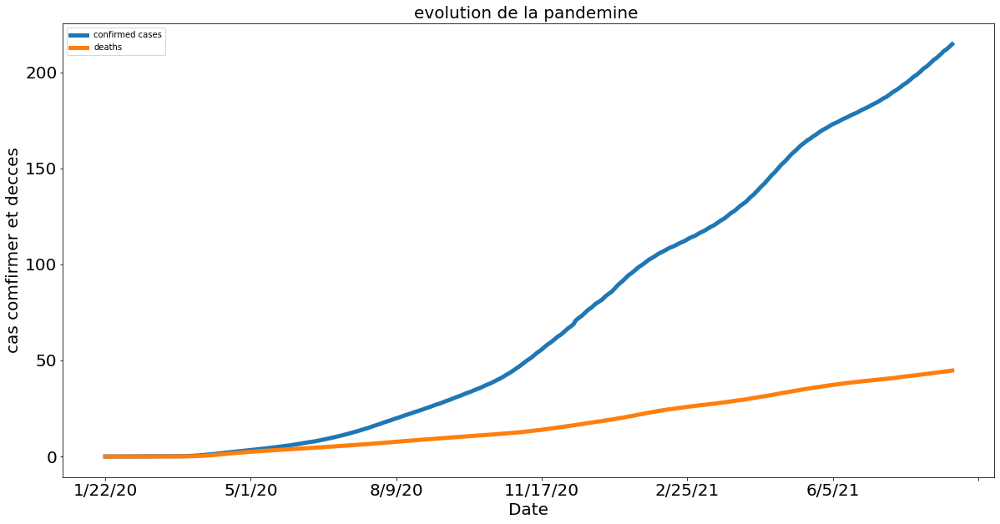

In [36]:
fig00=(df_evol/1000000).plot(figsize=(20,10), linewidth=5, fontsize=20,label='confirmed cases')
fig00=(death_evol/100000).plot(figsize=(20,10),linewidth=5,fontsize=20,label='deaths')
plt.xlabel('Date', fontsize=20)
plt.ylabel('cas comfirmer et decces', fontsize=20)
plt.legend()
plt.title('evolution de la pandemine ', fontsize=20)

### statestiques par population

#### pour cela on utulise un fichier csv qui contient la population de chaque pays 

In [37]:
df_pop = pd.read_csv('C://Users//youssef//Desktop//Nouveau dossier (3)//population.csv.csv')
df_pop.replace(('United States','Russian Federation'),('US','Russia'),inplace=True)
df_pop=df_pop[pd.to_numeric(df_pop['2019 [YR2019]'],errors='coerce').notnull()]
df_pop=df_pop.astype({'2019 [YR2019]':'int64'})

In [38]:
#cahngement au nom 'country dans tous les datat sets'
df_pop.rename(columns={'Country Name':'Country','2019 [YR2019]':'population'},inplace=True)
df_confirmed.rename(columns={'Country/Region':'Country'},inplace=True)
df_death.rename(columns={'Country/Region':'Country'},inplace=True)

# nom des pays en miniscule
df_confirmed.Country=df_confirmed.Country.str.lower()
df_death['Country']=df_death.Country.str.lower()
df_pop.Country=df_pop.Country.str.lower()

#fusion des data sets

population=df_pop.loc[:,['Country','population']]
confirmed_full=pd.merge(df_confirmed,population,'inner',on='Country')
deaths_full=pd.merge(df_death,population,'inner',on='Country')

# pays extreme 
df_confirmed_sum=confirmed_full.sort_values(by=df_confirmed.columns[-1],ascending=False)[0:10] #10 countries with most cases
last_countries=confirmed_full.sort_values(by=df_confirmed.columns[-1])[0:10] # 10 couontries with least cases
df_confirmed_sum.set_index('Country',inplace=True)
last_countries.set_index('Country',inplace=True)

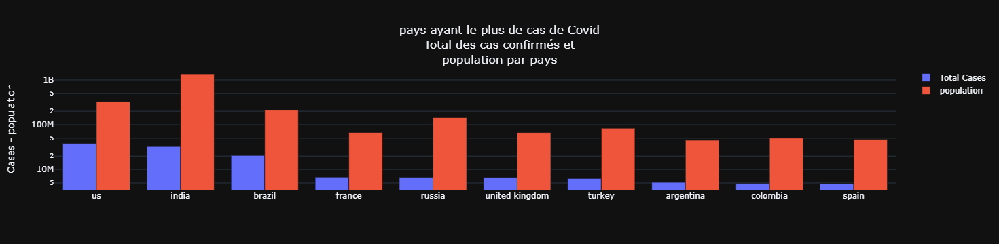

In [39]:
countries=df_confirmed_sum.index
cumulative = df_confirmed_sum.iloc[:,-2]
population=df_confirmed_sum.population
fig101 = go.Figure(data=[
    go.Bar(name='Total Cases', x=countries, y=cumulative),
    go.Bar(name='population', x=countries, y=population )
])

fig101.update_layout(barmode='group')
fig101.update_yaxes(type='log')

fig101.update_layout(title="pays ayant le plus de cas de Covid<br>Total des cas confirmés et<br>population par pays",
                title_x=0.5,
                  yaxis_title="Cases - population"
                    ,template='plotly_dark')
fig101.show()

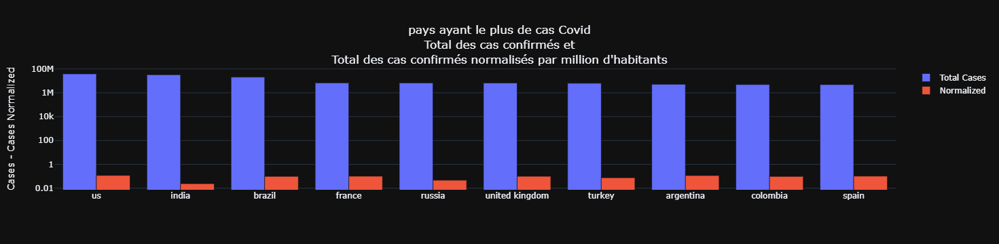

In [40]:

countries=df_confirmed_sum.index
cumulative = df_confirmed_sum.iloc[:,-2]
population=df_confirmed_sum.population
fig102 = go.Figure(data=[
    go.Bar(name='Total Cases', x=countries, y=cumulative),
    go.Bar(name='Normalized', x=countries, y=cumulative/population)
])

fig102.update_layout(barmode='group')
fig102.update_yaxes(type='log')

fig102.update_layout(title="pays ayant le plus de cas Covid<br>Total des cas confirmés et<br>Total des cas confirmés normalisés par million d'habitants",
                title_x=0.5,
                  yaxis_title="Cases - Cases Normalized"
                    ,template='plotly_dark')
fig102.show()

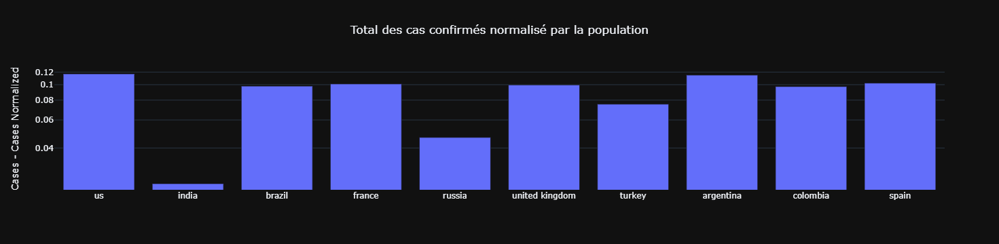

In [41]:

countries=df_confirmed_sum.index
cumulative = df_confirmed_sum.iloc[:,-2]
population=df_confirmed_sum.population
fig103 = go.Figure(data=[
    go.Bar(name='Normalized', x=countries, y=cumulative/population)
])

fig103.update_layout(barmode='group')
fig103.update_yaxes(type='log')

fig103.update_layout(title="Total des cas confirmés normalisé par la population",
                title_x=0.5,
                  yaxis_title="Cases - Cases Normalized",
                    template='plotly_dark')
fig103.show()

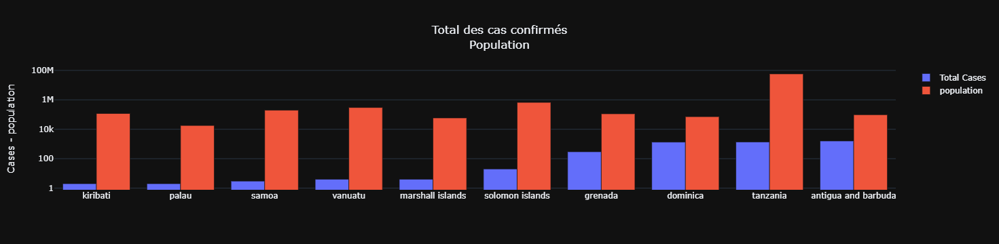

In [42]:

#countries with least nbre of cases
countries=last_countries.index
cumulative = last_countries.iloc[:,-2]
population=last_countries.population
fig104 = go.Figure(data=[
    go.Bar(name='Total Cases', x=countries, y=cumulative),
    go.Bar(name='population', x=countries, y=population)
])
# Change the bar mode
fig104.update_layout(barmode='group')
fig104.update_yaxes(type='log')

fig104.update_layout(title="Total des cas confirmés<br>Population",
                title_x=0.5,
                  yaxis_title="Cases - population",
                    template='plotly_dark')
fig104.show()

### transformation et pivotage de la data set pour visualiser la serie chronologique corespandante a chaque pays 

In [43]:
df=df_confirmed_sum.drop('population',axis=1)
df=df.transpose()
df.head()

Country,us,india,brazil,france,russia,united kingdom,turkey,argentina,colombia,spain
1/22/20,1,0,0,0,0,0,0,0,0,0
1/23/20,1,0,0,0,0,0,0,0,0,0
1/24/20,2,0,0,2,0,0,0,0,0,0
1/25/20,2,0,0,3,0,0,0,0,0,0
1/26/20,5,0,0,3,0,0,0,0,0,0


In [44]:
df=df_confirmed_sum.drop('population',axis=1)
data =df.reset_index().melt(id_vars='Country', var_name='date')
data.head()

,Country,date,value
0,us,1/22/20,1
1,india,1/22/20,0
2,brazil,1/22/20,0
3,france,1/22/20,0
4,russia,1/22/20,0


In [45]:
data.loc[(data.value < 1),'value']=None
data.head()

,Country,date,value
0,us,1/22/20,1.0
1,india,1/22/20,NaN
2,brazil,1/22/20,NaN
3,france,1/22/20,NaN
4,russia,1/22/20,NaN


In [46]:

df = data.pivot(index='date', columns='Country', values='value')
df.tail()

Country,argentina,brazil,colombia,france,india,russia,spain,turkey,united kingdom,us
date,,,,,,,,,,
9/5/20,471806.0,4123000.0,658456.0,357927.0,4113811.0,1017131.0,498989.0,278228.0,346513.0,6247601.0
9/6/20,478792.0,4137521.0,666521.0,364943.0,4204613.0,1022228.0,498989.0,279806.0,349500.0,6278819.0
9/7/20,488007.0,4147794.0,671848.0,369209.0,4280422.0,1027334.0,525549.0,281509.0,352453.0,6302432.0
9/8/20,500034.0,4162073.0,679513.0,375947.0,4370128.0,1032354.0,534513.0,283270.0,354934.0,6329658.0
9/9/20,512293.0,4197889.0,686851.0,384566.0,4465863.0,1037526.0,543379.0,284943.0,357615.0,6363707.0


In [47]:

datetime_index = pd.DatetimeIndex(df.index)
df.set_index(datetime_index,inplace=True)
df.head()

Country,argentina,brazil,colombia,france,india,russia,spain,turkey,united kingdom,us
date,,,,,,,,,,
2021-01-01,1629594.0,7700578.0,1654880.0,2697014.0,10325823.0,3153960.0,1928265.0,2220855.0,2549693.0,20254160.0
2021-01-10,1722217.0,8105790.0,1786900.0,2840864.0,10466595.0,3366715.0,2050360.0,2326256.0,3081372.0,22486135.0
2021-01-11,1730921.0,8131612.0,1801903.0,2844680.0,10479179.0,3389733.0,2111782.0,2336476.0,3127647.0,22700799.0
2021-01-12,1744704.0,8195637.0,1816082.0,2864360.0,10495147.0,3412390.0,2137220.0,2346285.0,3173295.0,22927766.0
2021-01-13,1757429.0,8256536.0,1831980.0,2888292.0,10512093.0,3434934.0,2176089.0,2355839.0,3220957.0,23158067.0


Text(0.5, 1.0, 'evolution des cas confrimer')

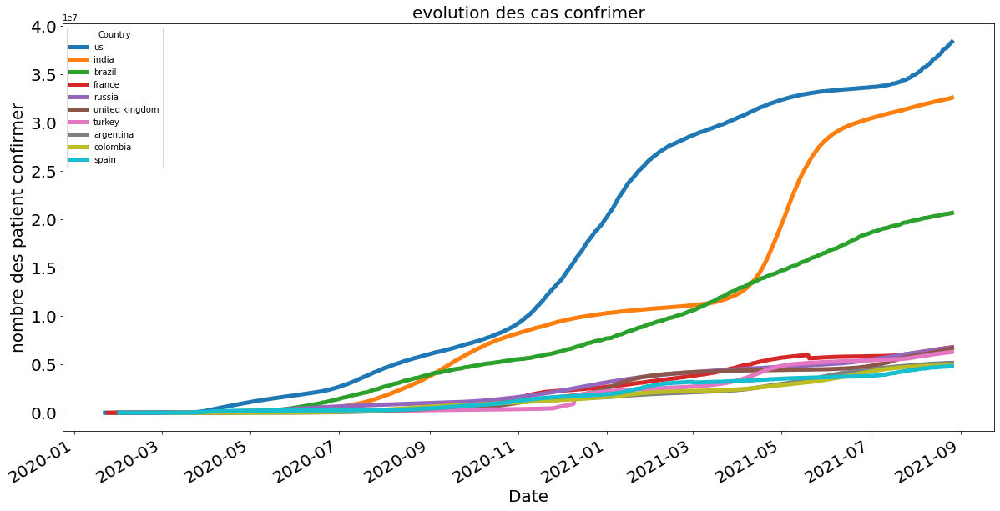

In [48]:

countries=df_confirmed_sum.index
df[countries].plot(figsize=(20,10), linewidth=5, fontsize=20)
plt.xlabel('Date', fontsize=20)
plt.ylabel('nombre des patient confirmer', fontsize=20)
plt.title('evolution des cas confrimer', fontsize=20)

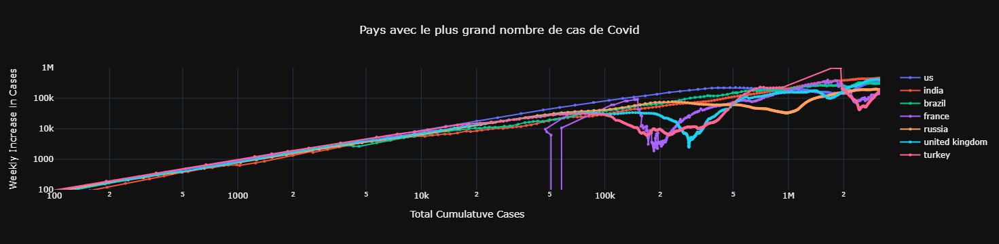

In [49]:

period = 7
xv = []
yv = []
for j  in range(7):
    y = df_confirmed_sum.iloc[j,:]
    yd = pd.Series(y).diff(periods=period)  
    xv.append(y[period:len(y)])
    yv.append(yd[period:len(y)])
    

fig55 = go.Figure()
for j in range(7):
    fig55.add_trace((go.Scatter(x=xv[j],
                                y=yv[j],
                                marker=dict(size=4),
                                mode='lines+markers',
                                name=df_confirmed_sum.index[j],
                                text=df_confirmed_sum.index[j]))) #
    
fig55.update_xaxes(range=[2, 6.5])
fig55.update_yaxes(range=[2, 6])
fig55.update_layout(title='Pays avec le plus grand nombre de cas de Covid',
                                    title_x=0.5,
                  xaxis_type="log",
                  yaxis_type="log",
                  xaxis_title="Total Cumulatuve Cases",
                  yaxis_title="Weekly Increase in Cases",
                    template='plotly_dark'
                  )

### visualisation des cas comfirmer vs decces vs gueris dans quelque pays 

In [50]:
confirmed_cases_data_url = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv'
death_cases_data_url = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv'
recovery_cases_data_url = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_recovered_global.csv'

In [51]:
df_confirmed = pd.read_csv(confirmed_cases_data_url)
df_death = pd.read_csv(death_cases_data_url)
df_recovered=pd.read_csv(recovery_cases_data_url)
df_confirmed.drop(['Province/State','Lat','Long'],axis=1,inplace=True)#dropping useless columns
df_death.drop(['Province/State','Lat','Long'],axis=1,inplace=True)
df_recovered.drop(['Province/State','Lat','Long'],axis=1,inplace=True)
df_confirmed=df_confirmed.groupby(['Country/Region'],as_index=False).sum()
df_death=df_death.groupby(['Country/Region'],as_index=False).sum()
df_recovered=df_recovered.groupby(['Country/Region'],as_index=False).sum()

In [52]:
last_update=pd.DataFrame({'cas confirmés':df_confirmed.iloc[:,-1].sum(),'décés':df_death.iloc[:,-1].sum(),'guéri':df_recovered.iloc[:,-1].sum()},index=[0])
last_update.head()
la=last_update.transpose()

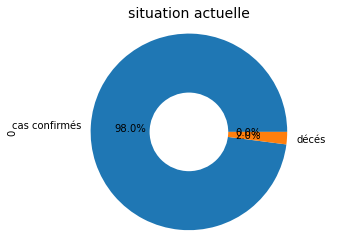

In [53]:
fig1,ax1=plt.subplots()
#ax1.pie( sizes,labels=labels, autopct='%1.1f%%', shadow=True)
#df[df["Last_Update"]==cdate.strftime('%Y-%m-%d')][cols].sum(axis = 0, skipna = True).astype(int).
la[0].plot(kind='pie', autopct='%1.1f%%', figsize=(10,5),subplots=True)
ax1.axis('equal')

#draw circle
centre_circle = plt.Circle((0,0),0.40,fc='white')
fig_round = plt.gcf()
fig_round.gca().add_artist(centre_circle)

plt.title('situation actuelle', fontsize=14)
plt.show()

In [54]:
data=pd.DataFrame()
df=df_confirmed.sort_values(by=df_confirmed.columns[-1],ascending=False)[0:10]
data['pays']=df['Country/Region']
data['confirme']=df.iloc[:,-1]
data['deces']=df_death.loc[df_death['Country/Region'].isin(data['pays'])].iloc[:,-1]
data['gueris']=df_recovered.loc[df_death['Country/Region'].isin(data['pays'])].iloc[:,-1]
data.set_index('pays',inplace=True)
data.loc['US','gueris']=25966389

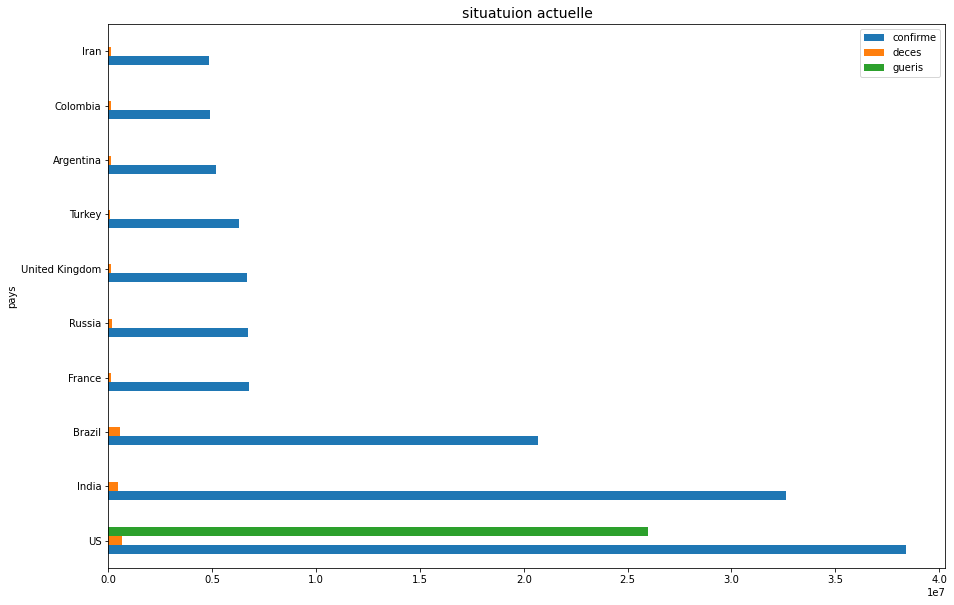

In [55]:
# bar plot for current status
data.plot(kind='barh', figsize=(15,10))
plt.title('situatuion actuelle', fontsize=14)
plt.show()

# creation de la carte choropleth 

In [1]:
import branca.colormap as cm
import folium
import geopandas as gpd
import numpy as np
import pandas as pd
import matplotlib as plt


#importation des donnes de covid ainsi que le fichier .shp pour les pays 

countries = gpd.read_file('C:\\Users\\youssef\\Desktop\\World_Countries\\World_Countries.shp')
corona = pd.read_csv("C:\\Users\\youssef\\Desktop\\owid-covid-data.csv.txt")

# renomer quelque pays dont le nom differe entre les deux base de donnes 

corona = corona.replace({'location' :
                      dict.fromkeys(['Taiwan',
                                     'Mainland China',
                                     'Hong Kong',
                                     'Macau'],
                                     'China')})
corona = corona.replace({'location' : 'US'},
                                'United States')
corona = corona.replace({'location' : 'UK'},
                                'United Kingdom')
corona = corona.replace({'location' : 'North Ireland'},
                                'United Kingdom')
corona = corona.replace({'location' : 'Republic of Ireland'},
                                'Ireland')
corona = corona.replace({'location' : 'Vatican City'},
                                'Italy')
corona = corona.replace({'location' : 'Byelarus'},
                               'Belarus')
corona = corona.replace({'location' : 'Macedonia'},
                               'North Macedonia')
countries = countries.rename(columns={'COUNTRY': 'location'})




# on vas travailler avec le log des cas donc en doit  eleminer les pays avec 0 cas

corona = corona[corona.total_cases != 0]


#Nous trions ensuite nos données par pays  

sorted_df = corona.sort_values(['location', 'date']).reset_index(drop=True)
sum_df = sorted_df.groupby(['location', 'date'], as_index=False).sum()

# Maintenant nous pouvons joindre les données et le fichier de forme ensemble :

joined_df = countries.merge(sum_df, on='location')
joined_df = joined_df[joined_df.total_cases != 0]

# ajout du log des cas confirmer 

joined_df['log_Confirmed'] = np.log10(joined_df['total_cases'])

#display(joined_df)


#Nous devons également convertir l'ObservationDate en temps unix en nanosecondes
joined_df['date_sec'] = pd.to_datetime(joined_df['date']).astype(np.int64)/ 10**9
joined_df['date_sec'] = joined_df['date_sec'].astype(int).astype(str)


#Nous pouvons maintenant sélectionner les colonnes nécessaires à la carte et éliminer les autres 
joined_df = joined_df[['location', 'date_sec','log_Confirmed', 'geometry']]

# initialisation de la carte :
mymap = folium.Map(tiles='cartodbpositron')
mymap.save(outfile='infinite_scroll.html')
mymap_fix_boundary = folium.Map(min_zoom=2, max_bounds=True, tiles='cartodbpositron')
mymap_fix_boundary.save(outfile='fix_boundary.html')

#Nous définissons maintenant une carte de couleurs en fonction du logarithme du nombre de cas confirmés :

max_colour = max(joined_df['log_Confirmed'])
min_colour = min(joined_df['log_Confirmed'])
cmap = cm.linear.YlOrRd_09.scale(min_colour, max_colour)
joined_df['colour'] = joined_df['log_Confirmed'].map(cmap)
country_list = joined_df['location'].unique().tolist()
country_idx = range(len(country_list))

# nous construisons notre dictionnaire de style :

style_dict = {}
for i in country_idx:
    country = country_list[i]
    result = joined_df[joined_df['location'] == country]
    inner_dict = {}
    for _, r in result.iterrows():
        inner_dict[r['date_sec']] = {'color': r['colour'], 'opacity': 0.7}
    style_dict[str(i)] = inner_dict
    
#Enfin, nous créons notre carte et ajoutons une barre de couleur :
  
countries_df = joined_df[['geometry']]
countries_gdf = gpd.GeoDataFrame(countries_df)
countries_gdf = countries_gdf.drop_duplicates().reset_index()

from folium.plugins import TimeSliderChoropleth

slider_map = folium.Map(min_zoom=2, max_bounds=True,tiles='cartodbpositron')

_ = TimeSliderChoropleth(
    data=countries_gdf.to_json(),
    styledict=style_dict,

).add_to(slider_map)

_ = cmap.add_to(slider_map)
cmap.caption = "log des cas confirmer"


# pour sauvgarder notre carte pour l ituliser apres 

slider_map.save(outfile='TimeSliderChoropleth.html')


C:\Users\youssef\anaconda3\lib\site-packages\ipykernel_launcher.py:64: FutureWarning: casting datetime64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.


## et voila notre carte 

In [ ]:
slider_map

# statestiques concernant les données  des Etats-Unis

#### preparation des données 

In [76]:
import pandas as pd
import plotly
import numpy as np
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import plotly.figure_factory as ff
import csv
from urllib.request import urlopen
import urllib.request
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.interpolate import interp1d
import plotly.graph_objects as go


In [57]:
url = "https://covidtracking.com/api/v1/us/daily.csv"
df = pd.read_csv(url)

In [58]:
# mise en forme de la colone date
df['year'] = df.date.astype(str).str[:4]
df['month_day'] = df.date.astype(str).str[-4:]
df['day'] = df.date.astype(str).str[-2:]
df['month'] = df.month_day.astype(str).str[:2]
df['date_new'] = df['year'] + "-" + df['month'] + "-" + df['day']
df['date_new'] = df['date_new'].astype('datetime64')
df.dtypes

date                                 int64
states                               int64
positive                           float64
negative                           float64
pending                            float64
hospitalizedCurrently              float64
hospitalizedCumulative             float64
inIcuCurrently                     float64
inIcuCumulative                    float64
onVentilatorCurrently              float64
onVentilatorCumulative             float64
dateChecked                         object
death                              float64
hospitalized                       float64
totalTestResults                     int64
lastModified                        object
recovered                          float64
total                                int64
posNeg                               int64
deathIncrease                        int64
hospitalizedIncrease                 int64
negativeIncrease                     int64
positiveIncrease                     int64
totalTestRe

In [59]:
#creation des nouveau colone telle que pourcentage pos/neg et cahngement ponctuel des cas pos/neg 
cases = df[['date_new', 'totalTestResultsIncrease', 'negativeIncrease', 'positiveIncrease', 'deathIncrease', 'hospitalizedIncrease']]
cases['percent_positive'] = cases['positiveIncrease']/cases['totalTestResultsIncrease']
cases['percent_negative'] = cases['negativeIncrease']/cases['totalTestResultsIncrease']
cases['percent_death'] = cases['deathIncrease']/cases['totalTestResultsIncrease']
cases['percent_hospitalized'] = cases['hospitalizedIncrease']/cases['totalTestResultsIncrease']
cases['positive_pct_change'] = cases['percent_positive'].pct_change()
cases['negative_pct_change'] = cases['percent_negative'].pct_change()
cases['total_cases_pct_change'] = cases['totalTestResultsIncrease'].pct_change()
cases['death_pct_change'] = cases['percent_death'].pct_change()
cases['hospitalized_pct_change'] = cases['percent_hospitalized'].pct_change()


In [60]:
# les donnes avant cette date sont pas  bien structuer, aprer cette date le flux des donner et plus coherant 
cases = cases[cases['date_new'] > '2020-03-20']

In [61]:

percent_positive = list(cases.percent_positive)
percent_negative = list(cases.percent_negative)
percent_death = list(cases.percent_death)
percent_hospitalized = list(cases.percent_hospitalized)

negativeIncrease = list(cases.negativeIncrease)
positiveIncrease = list(cases.positiveIncrease)
deathIncrease = list(cases.deathIncrease)
hospitalizedIncrease = list(cases.hospitalizedIncrease)

totalTestResultsIncrease = list(cases.totalTestResultsIncrease)
total_cases_pct_change = list(cases.total_cases_pct_change)
positive_pct_change = list(cases.positive_pct_change)
negative_pct_change = list(cases.negative_pct_change)
death_pct_change = list(cases.death_pct_change)
hospitalized_pct_change = list(cases.hospitalized_pct_change)
date = list(cases.date_new)

positive_pct_melt = pd.melt(cases, id_vars=['date_new'],value_vars=['positive_pct_change'])
negative_pct_melt = pd.melt(cases, id_vars=['date_new'],value_vars=['negative_pct_change'])
death_pct_melt = pd.melt(cases, id_vars=['date_new'],value_vars=['death_pct_change'])
hospitalized_pct_melt = pd.melt(cases, id_vars=['date_new'],value_vars=['hospitalized_pct_change'])
total_cases_pct_melt = pd.melt(cases, id_vars=['date_new'],value_vars=['total_cases_pct_change'])

cases_melted1 = positive_pct_melt.append(negative_pct_melt,ignore_index=True)
cases_melted2 = cases_melted1.append(death_pct_melt,ignore_index=True)
cases_melted3 = cases_melted2.append(hospitalized_pct_melt,ignore_index=True)
cases_melted = cases_melted3.append(total_cases_pct_melt,ignore_index=True)

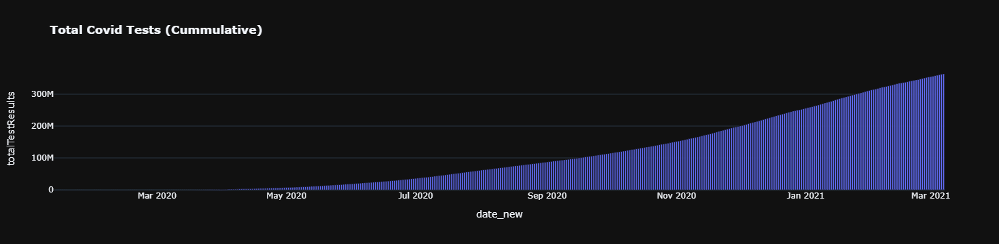

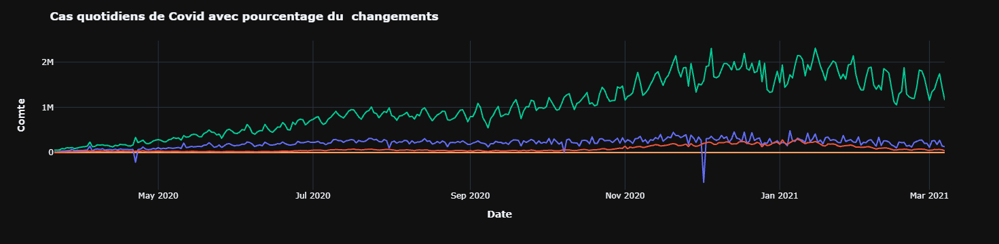

In [62]:
fig0 = px.bar(df
             ,x="date_new"
             ,y="totalTestResults"
             ,hover_data=['totalTestResults']
             ,title="<b>Total Covid Tests (Cummulative)</b>")

fig0.update_layout(
    template='plotly_dark'
)

percent_positive = list(cases.percent_positive)
percent_negative = list(cases.percent_negative)
date = list(cases.date_new)
cases_melt = pd.melt(cases, id_vars=['date_new'], value_vars=['negativeIncrease'
                                                              ,'positiveIncrease'
                                                              ,'totalTestResultsIncrease'
                                                             ]
                    )
fig0.show()
fig1 = make_subplots(specs=[[{"secondary_y": True}]])
fig1 = px.line(cases_melt, x='date_new', y='value', color='variable')
fig1.add_trace(
    go.Scatter(x=date, y=percent_negative, name="pourcentage_négatif"),
    secondary_y=False,
)

fig1.add_trace(
    go.Scatter(x=date, y=percent_positive, name="pourcentage_positif"),
    secondary_y=False,
)

fig1.update_layout(
    title_text="<b>Cas quotidiens de Covid avec pourcentage du  changements </b>"
    ,template='plotly_dark'
    ,showlegend=False
)

fig1.update_xaxes(title_text="<b>Date</b>")
fig1.update_yaxes(title_text="<b>Comte</b>", secondary_y=False)
fig1.show()

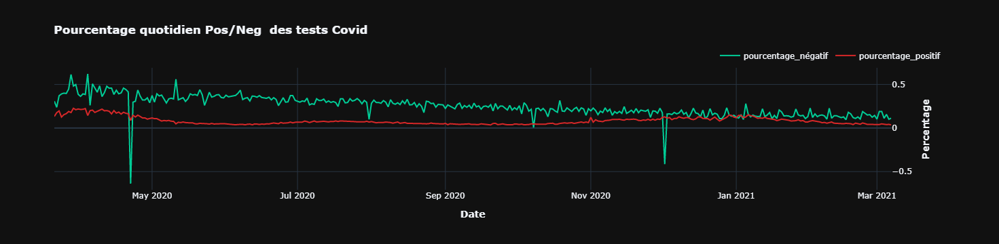

In [63]:
fig2 = make_subplots(specs=[[{"secondary_y": True}]])
fig2.add_trace(
    go.Scatter(x=date
               ,y=percent_negative
               ,name="pourcentage_négatif"
               ,marker_color=px.colors.qualitative.Plotly[2]),
    secondary_y=True,
)
fig2.add_trace(
    go.Scatter(x=date
               ,y=percent_positive
               ,name="pourcentage_positif"
               ,marker_color=px.colors.qualitative.D3[3]),
    secondary_y=True,
)

fig2.update_layout(
    title_text="<b> Pourcentage quotidien Pos/Neg  des tests Covid</b>"
)

fig2.update_xaxes(title_text="<b>Date</b>")
fig2.update_yaxes(title_text="<b>Percentage</b>", secondary_y=True)
fig2.update_layout(barmode='stack')
fig2.update_traces(marker_line_width=.01)
fig2.update_layout(
    template='plotly_dark'
    ,legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))

fig2.show()

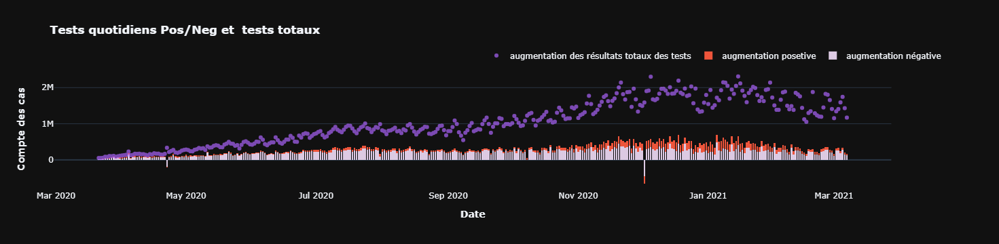

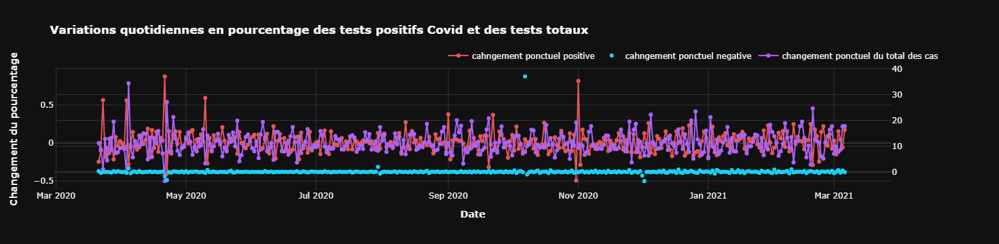

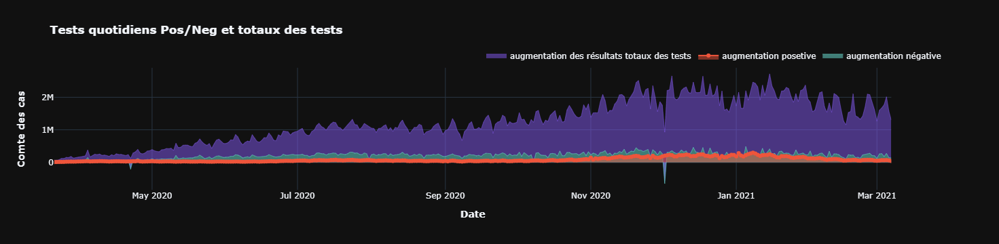

In [64]:
fig3 = make_subplots(specs=[[{"secondary_y": True}]])

fig3.add_trace(
    go.Bar(x=date
           ,y=negativeIncrease
           ,name="augmentation négative"
           ,marker_color=px.colors.qualitative.Pastel1[3]),
    secondary_y=False,
)
fig3.add_trace(
    go.Bar(x=date
           ,y=positiveIncrease
           ,name="augmentation posetive"),
    secondary_y=False,
)
fig3.add_trace(
    go.Scatter(x=date
               ,y=totalTestResultsIncrease
               ,opacity=.7
               ,name="augmentation des résultats totaux des tests"
               ,mode="markers"
               ,marker_color=px.colors.qualitative.Plotly[3]),
    secondary_y=False,
)

fig3.update_layout(
    title_text="<b>Tests quotidiens Pos/Neg et  tests totaux</b>"
)
fig3.update_xaxes(title_text="<b>Date</b>")
fig3.update_yaxes(title_text="<b>Compte des cas</b>", secondary_y=False)
fig3.update_layout(barmode='stack')
fig3.update_traces(marker_line_width=.01)
fig3.update_layout(
    template='plotly_dark'
    ,legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))

fig3.show()
fig4 = make_subplots(specs=[[{"secondary_y": True}]])

fig4.add_trace(
    go.Scatter(x=date
               ,y=positive_pct_change
               ,name="cahngement ponctuel positive"
               ,mode="lines+markers"
               ,marker_color=px.colors.qualitative.T10[2]),
    secondary_y=False,
)
fig4.add_trace(
    go.Scatter(x=date
               ,y=negative_pct_change
               ,name="cahngement ponctuel negative"
               ,mode="markers"
               ,marker_color=px.colors.qualitative.Plotly[5]),
    secondary_y=True,
)
fig4.add_trace(
    go.Scatter(x=date
               ,y=total_cases_pct_change
               ,name="changement ponctuel du total des cas "
               ,mode="lines+markers"
               ,marker_color=px.colors.qualitative.Plotly[3]),
    secondary_y=False,
)

fig4.update_layout(
    title_text="<b>Variations quotidiennes en pourcentage des tests positifs Covid et des tests totaux</b>"
)

fig4.update_xaxes(title_text="<b>Date</b>")
fig4.update_yaxes(title_text="<b>Changement du pourcentage</b>", secondary_y=False)
fig4.update_layout(barmode='stack')
fig4.update_traces(marker_line_width=.01)
fig4.update_layout(
    template='plotly_dark'
    ,legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))

fig4.show()
fig5 = make_subplots(specs=[[{"secondary_y": True}]])
fill_colors = ['none', 'tozeroy', 'tozerox', 'tonexty', 'tonextx', 'toself', 'tonext']
fig5.add_trace(
    go.Scatter(x=date
           ,y=negativeIncrease
           ,name="augmentation négative"
           ,line=dict(width=0.5, color='rgb(111, 231, 219)')
           ,stackgroup='one'
            ),
    secondary_y=False,
)
fig5.add_trace(
    go.Scatter(x=date
           ,y=positiveIncrease
           ,fill=fill_colors[1]
           ,mode="markers+lines"
           ,name="augmentation posetive"),
    secondary_y=False,
)
fig5.add_trace(
    go.Scatter(x=date
               ,y=totalTestResultsIncrease
               ,opacity=.7
               ,name="augmentation des résultats totaux des tests"
               ,line=dict(width=0.5, color='rgb(131, 90, 241)')
               ,stackgroup='one'),
    secondary_y=False,
)
fig5.update_layout(
    title_text="<b>Tests quotidiens Pos/Neg et totaux des tests</b>"
)
fig5.update_xaxes(title_text="<b>Date</b>")
fig5.update_yaxes(title_text="<b>Comte des cas</b>", secondary_y=False)
fig5.update_layout(barmode='stack')
fig5.update_traces(marker_line_width=.01)
fig5.update_layout(
    template='plotly_dark'
    ,legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))
fig5.show()

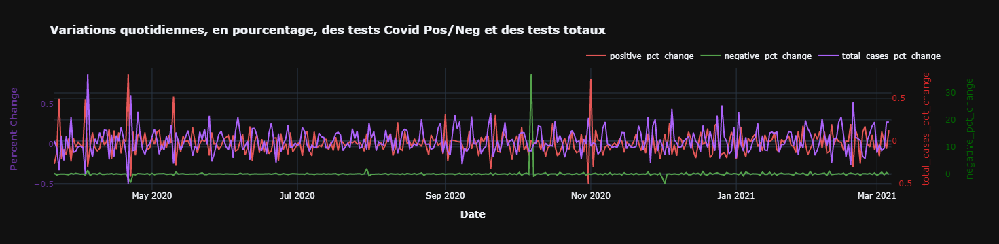

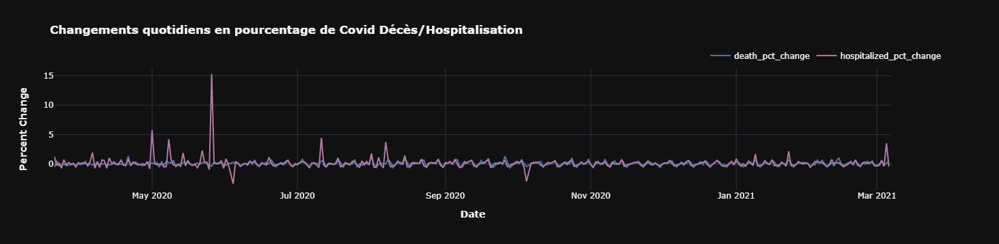

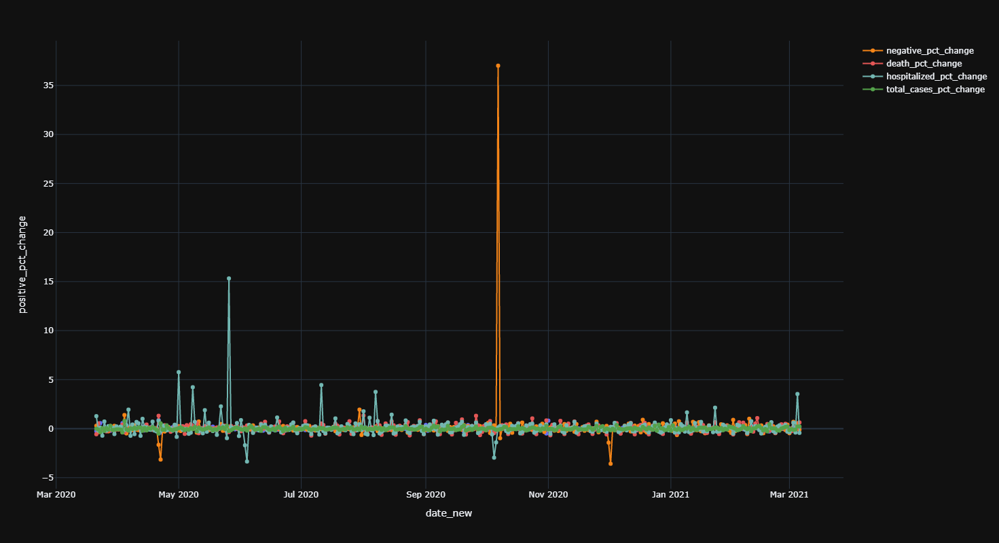

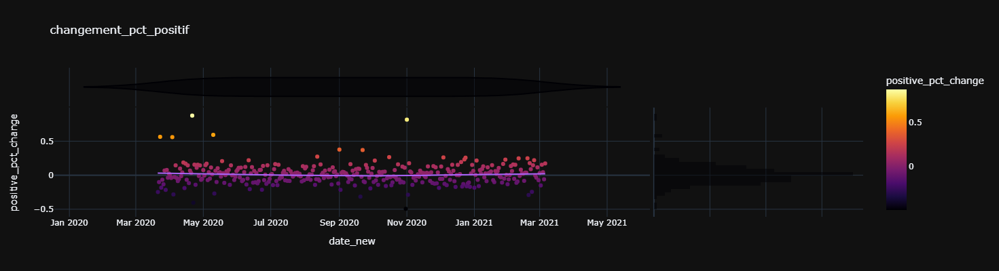

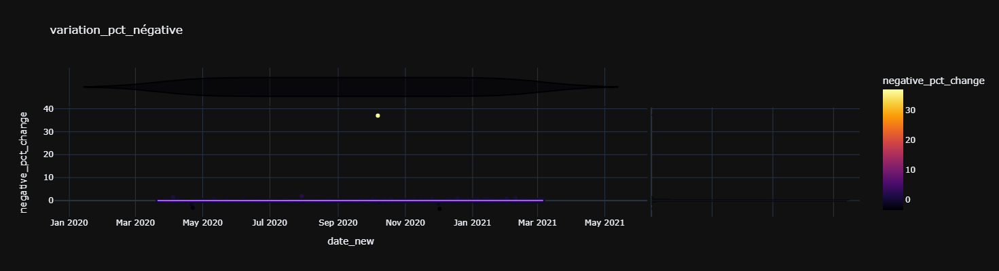

In [65]:
fig6 = make_subplots(specs=[[{"secondary_y": True}]])

fig6.add_trace(
    go.Scatter(x=date
               ,y=positive_pct_change
               ,name="positive_pct_change"
               ,marker_color=px.colors.qualitative.T10[2]
               ,yaxis="y1")

)
fig6.add_trace(
    go.Scatter(x=date
               ,y=negative_pct_change
               ,name="negative_pct_change"
               ,marker_color=px.colors.qualitative.T10[4]
               ,yaxis="y2")

)
fig6.add_trace(
    go.Scatter(x=date
               ,y=total_cases_pct_change
               ,name="total_cases_pct_change"
               ,marker_color=px.colors.qualitative.Plotly[3]
               ,yaxis="y3")

)

fig6.update_layout(
    
    yaxis1=dict(
        title="positive_pct_change",
        titlefont=dict(
            color="#663399"
        ),
        tickfont=dict(
            color="#663399"
        )
    ),
    yaxis2=dict(
        title="negative_pct_change",
        titlefont=dict(
            color="#006600"
        ),
        tickfont=dict(
            color="#006600"
        ),
        anchor="free",
        overlaying="y",
        side="right",
        position=1
    ),
    yaxis3=dict(
        title="total_cases_pct_change",
        titlefont=dict(
            color="#d62728"
        ),
        tickfont=dict(
            color="#d62728"
        ),
        anchor="x",
        overlaying="y",
        side="right"
    )
)


fig6.update_layout(
    title_text="<b>Variations quotidiennes, en pourcentage, des tests Covid Pos/Neg et des tests totaux</b>"
)

fig6.update_xaxes(title_text="<b>Date</b>")

fig6.update_yaxes(title_text="<b>Percent Change</b>", secondary_y=False)

fig6.update_layout(barmode='stack')
fig6.update_traces(marker_line_width=.01)

fig6.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))

fig6.update_layout(

    template='plotly_dark'
)
fig6.show()


fig7 = make_subplots(specs=[[{"secondary_y": True}]])

fig7.add_trace(
    go.Scatter(x=date
               ,y=death_pct_change
               ,name="death_pct_change"
               ,marker_color=px.colors.qualitative.T10[0]),
    secondary_y=False,
)
fig7.add_trace(
    go.Scatter(x=date
               ,y=hospitalized_pct_change
               ,name="hospitalized_pct_change"
               ,marker_color=px.colors.qualitative.T10[6]),
    secondary_y=False,
)


fig7.update_layout(
    title_text="<b>Changements quotidiens en pourcentage de Covid Décès/Hospitalisation</b>"
)

fig7.update_xaxes(title_text="<b>Date</b>")


fig7.update_yaxes(title_text="<b>Percent Change</b>", secondary_y=False)

fig7.update_layout(barmode='stack')


fig7.update_traces(

                  marker_line_width=.1)
fig7.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1,
))

fig7.update_layout(
  
    template='plotly_dark'
)
fig7.show()


fig8 = px.scatter(cases
                 ,x="date_new"
                 ,y="positive_pct_change"
                 ,trendline="lowess"
                 ,color_continuous_scale=px.colors.sequential.Inferno
                )
fig8.update_layout(
    height=800
    ,template='plotly_dark')

fig8.add_trace(
    go.Scatter(x=date
               ,y=negative_pct_change
               ,name="negative_pct_change"
               ,mode="lines+markers"
               ,marker_color=px.colors.qualitative.T10[1]
              )
),
fig8.add_trace(
    go.Scatter(x=date
               ,y=death_pct_change
               ,name="death_pct_change"
               ,mode="lines+markers"
               ,marker_color=px.colors.qualitative.T10[2]
              )
),
fig8.add_trace(
    go.Scatter(x=date
               ,y=hospitalized_pct_change
               ,name="hospitalized_pct_change"
               ,mode="lines+markers"
               ,marker_color=px.colors.qualitative.T10[3]
              )
),
fig8.add_trace(
    go.Scatter(x=date
               ,y=total_cases_pct_change
               ,name="total_cases_pct_change"
               ,mode="lines+markers"
               ,marker_color=px.colors.qualitative.T10[4]
              )

)
fig8.show()
fig9 = px.scatter(cases, x="date_new", y="positive_pct_change", trendline="lowess"
                  , title="changement_pct_positif"
                  , color="positive_pct_change", color_continuous_scale=px.colors.sequential.Inferno
                  , marginal_y="histogram", marginal_x="violin")
fig9.update_layout(
    height=400
    ,template='plotly_dark')
fig9.show()
fig10 = px.scatter(cases, x="date_new", y="negative_pct_change", color="negative_pct_change"
                  , trendline="lowess", title="variation_pct_négative"
                  , color_continuous_scale=px.colors.sequential.Inferno
                  , marginal_y="histogram", marginal_x="violin")
fig10.update_layout(
    height=400
    ,template='plotly_dark')
fig10.show()

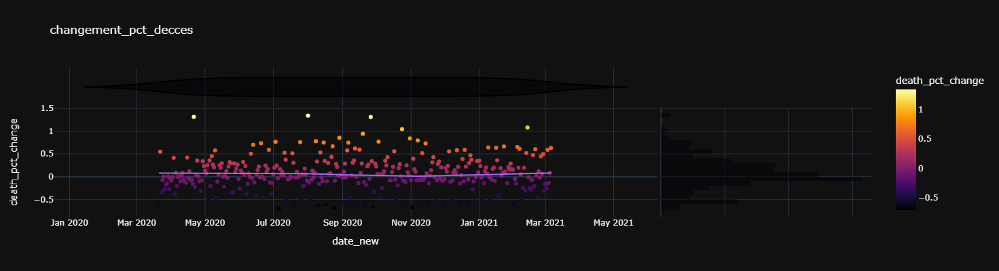

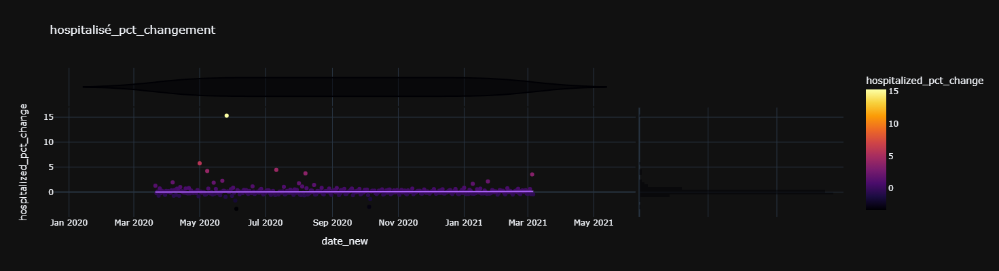

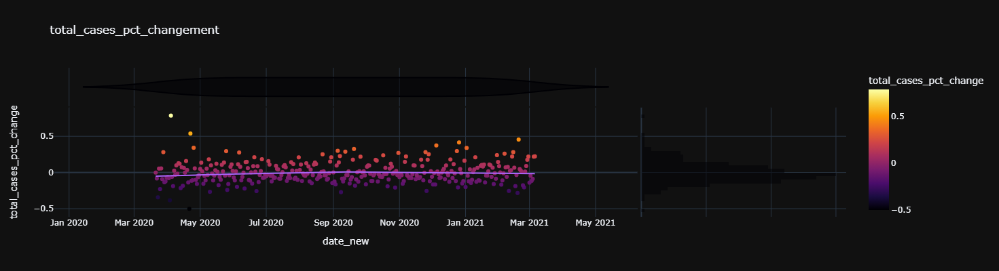

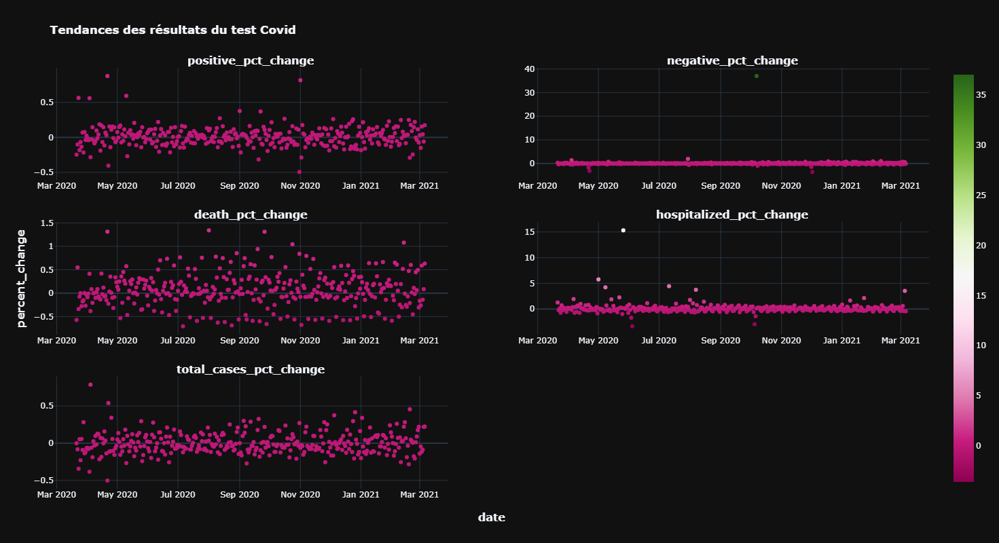

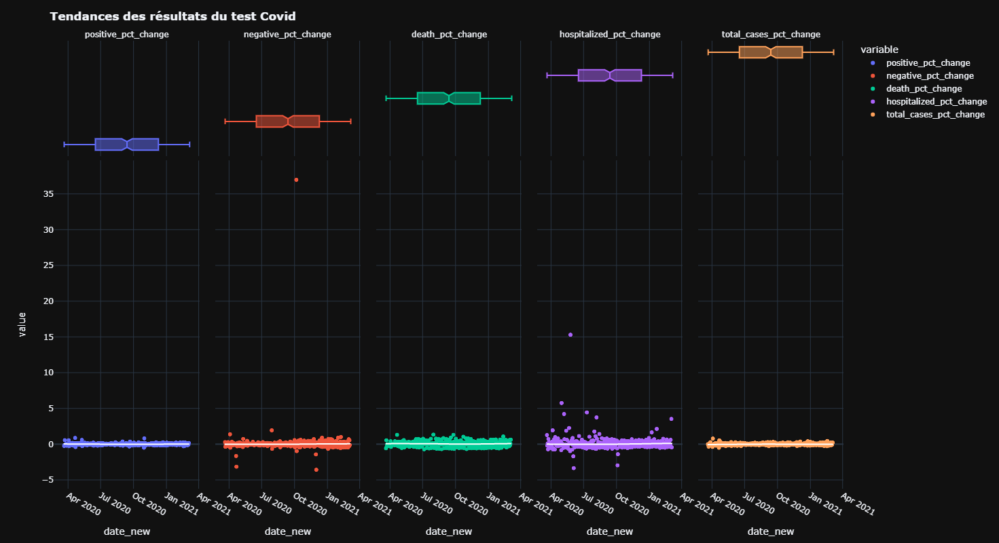

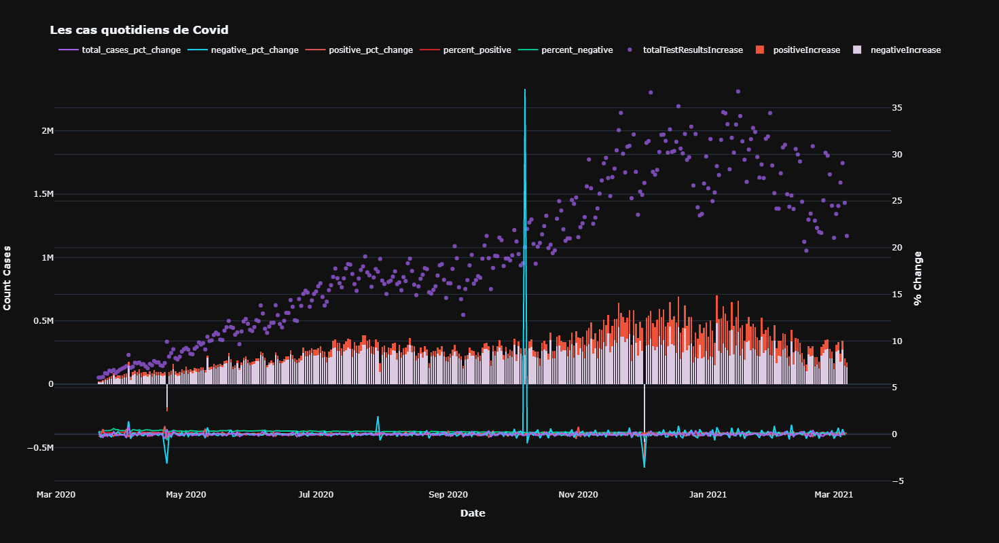

In [66]:
fig11 = px.scatter(cases, x="date_new", y="death_pct_change", color="death_pct_change"
                  , trendline="lowess", title="changement_pct_decces"
                  , color_continuous_scale=px.colors.sequential.Inferno
                  , marginal_y="histogram", marginal_x="violin")
fig11.update_layout(
    height=400
    ,template='plotly_dark')
fig11.show()

fig12 = px.scatter(cases, x="date_new", y="hospitalized_pct_change", color="hospitalized_pct_change"
                  , trendline="lowess", title="hospitalisé_pct_changement"
                  , color_continuous_scale=px.colors.sequential.Inferno
                  , marginal_y="histogram", marginal_x="violin")
fig12.update_layout(
    height=400
    ,template='plotly_dark')
fig12.show()

fig13 = px.scatter(cases, x="date_new", y="total_cases_pct_change", color="total_cases_pct_change"
                  , trendline="lowess", title="total_cases_pct_changement"
                  , color_continuous_scale=px.colors.sequential.Inferno
                  , marginal_y="histogram", marginal_x="violin")
fig13.update_layout(
    height=400
    ,template='plotly_dark')
fig13.show()


trace1 = fig9['data'][0]
trace2 = fig10['data'][0]
trace3 = fig11['data'][0]
trace4 = fig12['data'][0]
trace5 = fig13['data'][0]

fig14 = make_subplots(rows=3
                    ,cols=2
                    ,shared_xaxes=False
                    ,row_heights=[9., 9., 9.]
                    ,column_widths=[.1, .1]
                    ,shared_yaxes=False
                    ,vertical_spacing=0.10
                    ,subplot_titles=['<b>positive_pct_change</b>'
                                     ,'<b>negative_pct_change</b>'
                                     ,'<b>death_pct_change</b>'
                                     ,'<b>hospitalized_pct_change</b>'
                                     ,'<b>total_cases_pct_change</b>'
                                    ]
                    ,x_title="<b>date</b>"
                    ,y_title="<b>percent_change</b>"
                   )

fig14.add_trace(trace1, row=1, col=1)
fig14.add_trace(trace2, row=1, col=2)
fig14.add_trace(trace3, row=2, col=1)
fig14.add_trace(trace4, row=2, col=2)
fig14.add_trace(trace5, row=3, col=1)

fig14['layout'].update(height=800
# , width=1200
        , title='<b>Tendances des résultats du test Covid</b>'
        , template='plotly_dark')
fig14.show()


cases_melted.variable.value_counts()
values_list = list(cases_melted.value)

fig15 = px.scatter(cases_melted, x="date_new", y="value"
                 , color="variable", facet_col="variable"
                 , trendline="lowess", trendline_color_override="white"
                 , color_continuous_scale=px.colors.sequential.Inferno
                 , marginal_y="bar", marginal_x="box"
                 , labels = ['test','test','test','test','test'])

fig15['layout'].update(height=800
# , width=1200
        , title='<b>Tendances des résultats du test Covid</b>'
        , template='plotly_dark')
fig15.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig15.show()

#variable pour les sous graphs
percent_positive = list(cases.percent_positive)
percent_negative = list(cases.percent_negative)
negativeIncrease = list(cases.negativeIncrease)
positiveIncrease = list(cases.positiveIncrease)
totalTestResultsIncrease = list(cases.totalTestResultsIncrease)
total_cases_pct_change = list(cases.total_cases_pct_change)
positive_pct_change = list(cases.positive_pct_change)
date = list(cases.date_new)


fig16 = make_subplots(specs=[[{"secondary_y": True}]])


fig16.add_trace(
    go.Bar(x=date
           ,y=negativeIncrease
           ,name="negativeIncrease"
           ,marker_color=px.colors.qualitative.Pastel1[3]),
    secondary_y=False,
)
fig16.add_trace(
    go.Bar(x=date, y=positiveIncrease, name="positiveIncrease"),
    secondary_y=False,
)
fig16.add_trace(
    go.Scatter(x=date
               ,y=totalTestResultsIncrease
               ,opacity=.7
               ,name="totalTestResultsIncrease"
               ,mode="markers"
               ,marker_color=px.colors.qualitative.Plotly[3]),
    secondary_y=False,
)
fig16.add_trace(
    go.Scatter(x=date
               ,y=percent_negative
               ,name="percent_negative"
               ,marker_color=px.colors.qualitative.Plotly[2]),
    secondary_y=True,
)
fig16.add_trace(
    go.Scatter(x=date
               ,y=percent_positive
               ,name="percent_positive"
               ,marker_color=px.colors.qualitative.D3[3]),
    secondary_y=True,
)
fig16.add_trace(
    go.Scatter(x=date
               ,y=positive_pct_change
               ,name="positive_pct_change"
               ,marker_color=px.colors.qualitative.T10[2]),
    secondary_y=True,
)
fig16.add_trace(
    go.Scatter(x=date
               ,y=negative_pct_change
               ,name="negative_pct_change"
               ,marker_color=px.colors.qualitative.Plotly[5]),
    secondary_y=True,
)
fig16.add_trace(
    go.Scatter(x=date
               ,y=total_cases_pct_change
               ,name="total_cases_pct_change"
               ,marker_color=px.colors.qualitative.Plotly[3]),
    secondary_y=True,
)


fig16.update_layout(
    title_text="<b>Les cas quotidiens de Covid</b>"
    ,height=800
    # ,width=1200
)


fig16.update_xaxes(title_text="<b>Date</b>")

fig16.update_yaxes(title_text="<b>Count Cases</b>", secondary_y=False)
fig16.update_yaxes(title_text="<b>% Change</b>", secondary_y=True)


fig16.update_layout(barmode='stack')


fig16.update_traces(marker_line_width=.01)

fig16.update_layout(
    template='plotly_dark'
    ,legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))
fig16.show()

### passons au graphiques par jour

In [67]:
#creation du colomn des jours
s = pd.date_range(min(df.date_new),max(df.date_new), freq='D').to_series()
s = s.dt.dayofweek.tolist()
df['day_of_week'] = s

def day_of_week(df):
    if df['day_of_week'] == 0:
        return "Tuesday"
    elif df['day_of_week'] == 1:
        return "Monday"
    elif df['day_of_week'] == 2:
        return "Sunday"
    elif df['day_of_week'] == 3:
        return "Saturday"
    elif df['day_of_week'] == 4:
        return "Friday"
    elif df['day_of_week'] == 5:
        return "Thursday"
    elif df['day_of_week'] == 6:
        return "Wednesday"
    else:
        return ""

df['dayofweek'] = df.apply(day_of_week, axis=1)

#min et max
y_min = min(df.totalTestResultsIncrease)
y_max = max(df.totalTestResultsIncrease)

x_min = min(df.month)
x_max = max(df.month)
x_range = [x_min,x_max]
y_range = [y_min,y_max]

#creation total pos/neg/total variables par  jour 

total_pos_increase_grp_day = df.groupby(['dayofweek'])['positiveIncrease'].sum()
avg_total_pos_increase_grp_day = df.groupby(['dayofweek'])['positiveIncrease'].mean()

total_neg_increase_grp_day = df.groupby(['dayofweek'])['negativeIncrease'].sum()
avg_total_neg_increase_grp_day = df.groupby(['dayofweek'])['negativeIncrease'].mean()

total_increase_grp_day = df.groupby(['dayofweek'])['totalTestResultsIncrease'].sum()
avg_total_increase_grp_day = df.groupby(['dayofweek'])['totalTestResultsIncrease'].mean()

avg_total_per_week = avg_total_increase_grp_day/7
avg_pos_per_week = avg_total_pos_increase_grp_day/7
avg_neg_per_week = avg_total_neg_increase_grp_day/7

total_totals = list(total_increase_grp_day)
pos_totals = list(total_pos_increase_grp_day)
neg_totals = list(total_neg_increase_grp_day)

#list des jours
x_labels = ['Monday','Tuesday','Wednesday','Thursday', 'Friday', 'Saturday', 'Sunday']


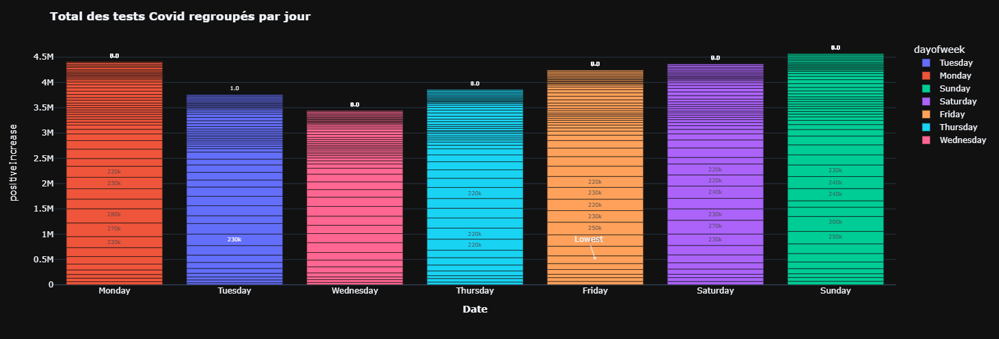

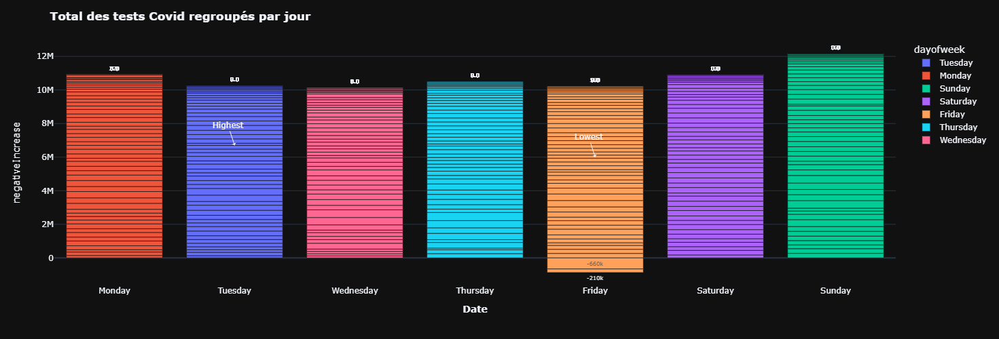

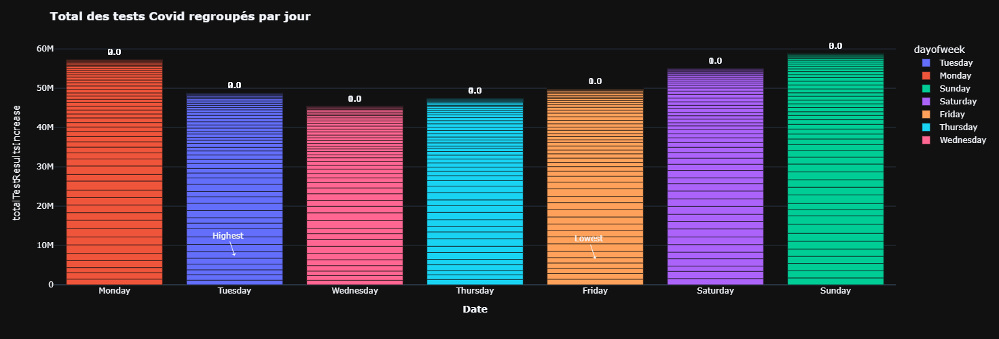

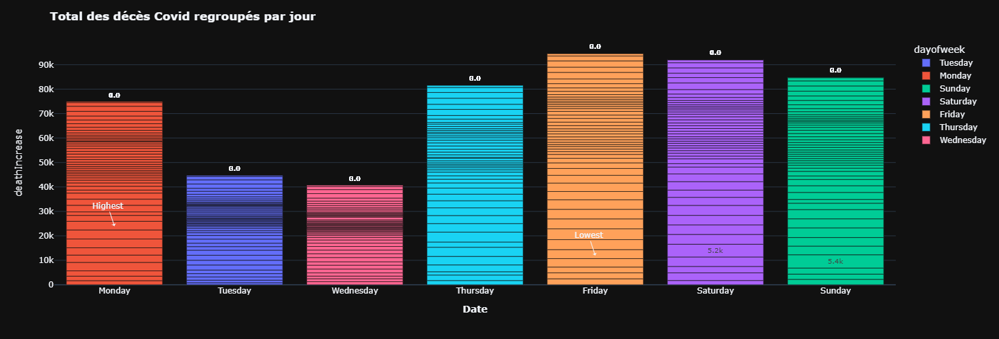

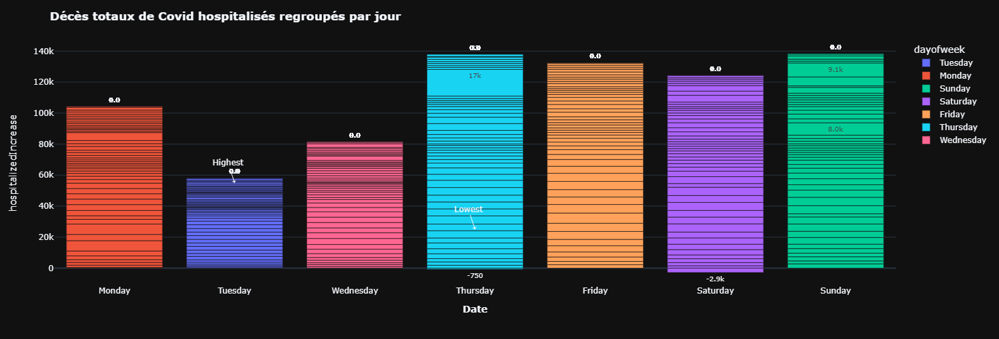

ValueError: Value of 'facet_col' is not the name of a column in 'data_frame'. Expected one of ['date_new', 'variable', 'value', 'dayofweek_x', 'rank_value', 'dayofweek_y'] but received: dayofweek

In [78]:
fig17 = px.bar(df
             ,x='dayofweek'
             ,y='positiveIncrease'
             ,text='positiveIncrease'
             ,color='dayofweek'
             ,height=500
             ,hover_data=['negativeIncrease', 'positiveIncrease', 'totalTestResultsIncrease']
             ,hover_name="positiveIncrease")
fig17.update_traces(texttemplate='%{text:.2s}'
                  ,textposition='outside')
fig17.update_layout(uniformtext_minsize=8
                 ,uniformtext_mode='hide'
                 ,title_text="<b>Covid Tests Outcome</b>"
                 ,template='plotly_dark'
              
                 )


fig17.update_xaxes(title_text="<b>Date</b>")

fig17.add_shape( 
    type="line", line_color="salmon", line_width=3, opacity=1, line_dash="dot",
    x0=0, x1=1, xref="paper", y0=avg_total_increase_grp_day, y1=avg_total_increase_grp_day, yref="y"
)

fig17.add_annotation( 
    text="Lowest", x="Friday", y=500000, arrowhead=1, showarrow=True
)

total_labels = [{"x": x, "y": pos_totals*1.3, "text": str(pos_totals), "showarrow": False} for x, pos_totals in zip(x_labels, pos_totals)]

fig17.update_layout(uniformtext_minsize=8
                 ,uniformtext_mode='hide'
                 # ,width=1200
                 ,title_text="<b>Total des tests Covid regroupés par jour</b>"
                 ,template='plotly_dark'
                 ,xaxis={'categoryorder':'array', 'categoryarray':['Monday','Tuesday','Wednesday','Thursday', 'Friday', 'Saturday', 'Sunday']}
                
                 )
fig17.show()



fig18 = px.bar(df
             ,x='dayofweek'
             ,y='negativeIncrease'
             ,text='negativeIncrease'
             ,color='dayofweek'
             ,height=500
             ,hover_data=['negativeIncrease', 'positiveIncrease', 'totalTestResultsIncrease']
             ,hover_name="negativeIncrease")
fig18.update_traces(texttemplate='%{text:.2s}'
                  ,textposition='outside')
fig18.update_layout(uniformtext_minsize=8
                 ,uniformtext_mode='hide'
                 ,template='plotly_dark'
                 ,title_text="<b> Tests Neagtive Covid groupés par jour</b>"
                 ,xaxis={'categoryorder':'array', 'categoryarray':['Monday','Tuesday','Wednesday','Thursday', 'Friday', 'Saturday', 'Sunday']})


fig18.update_xaxes(title_text="<b>Date</b>")

fig18.add_shape( 
    type="line", line_color="salmon", line_width=3, opacity=1, line_dash="dot",
    x0=0, x1=1, xref="paper", y0=avg_total_increase_grp_day, y1=avg_total_increase_grp_day, yref="y"
)

fig18.add_annotation( 
    text="Highest", x="Tuesday", y=6700000, arrowhead=1, showarrow=True
)

fig18.add_annotation( # add a text callout with arrow
    text="Lowest", x="Friday", y=6000000, arrowhead=1, showarrow=True
)

total_labels = [{"x": x, "y": neg_totals*1.25, "text": str(neg_totals), "showarrow": False} for x, neg_totals in zip(x_labels, neg_totals)]

fig18.update_layout(uniformtext_minsize=8
                 ,uniformtext_mode='hide'
                 # ,width=1200
                 ,title_text="<b>Total des tests Covid regroupés par jour</b>"
                 ,template='plotly_dark'
                 ,xaxis={'categoryorder':'array', 'categoryarray':['Monday','Tuesday','Wednesday','Thursday', 'Friday', 'Saturday', 'Sunday']}
                 # ,annotations=total_labels
                 )
fig18.show()


fig19 = px.bar(df
             ,x='dayofweek'
             ,y='totalTestResultsIncrease'
             ,text='totalTestResultsIncrease'
             ,color='dayofweek'
             ,height=500
             ,hover_data=['negativeIncrease', 'positiveIncrease', 'totalTestResultsIncrease']
             ,hover_name="totalTestResultsIncrease")
fig19.update_traces(texttemplate='%{text:.2s}'
                  ,textposition='outside')


fig19.update_xaxes(title_text="<b>Date</b>")

fig19.add_shape( 
    type="line", line_color="salmon", line_width=3, opacity=1, line_dash="dot",
    x0=0, x1=1, xref="paper", y0=avg_total_increase_grp_day, y1=avg_total_increase_grp_day, yref="y"
)

fig19.add_annotation( 
    text="Highest", x="Tuesday", y=7400000, arrowhead=1, showarrow=True
)

fig19.add_annotation( 
    text="Lowest", x="Friday", y=6600000, arrowhead=1, showarrow=True
)

total_labels = [{"x": x, "y": total_totals*.95, "text": str(total_totals), "showarrow": True} for x, total_totals in zip(x_labels, total_totals)]

fig19.update_layout(uniformtext_minsize=8
                 ,uniformtext_mode='hide'
                 ,title_text="<b>Total des tests Covid regroupés par jour</b>"
                 ,template='plotly_dark'
                 # ,width=1200
                 ,xaxis={'categoryorder':'array', 'categoryarray':['Monday','Tuesday','Wednesday','Thursday', 'Friday', 'Saturday', 'Sunday']}
                 
                 )
fig19.show()


#decces

fig20 = px.bar(df
             ,x='dayofweek'
             ,y='deathIncrease'
             ,text='deathIncrease'
             ,color='dayofweek'
             ,height=500
             ,hover_data=['negativeIncrease', 'positiveIncrease', 'totalTestResultsIncrease','deathIncrease']
             ,hover_name="deathIncrease")
fig20.update_traces(texttemplate='%{text:.2s}'
                  ,textposition='outside')
fig20.update_layout(uniformtext_minsize=8
                 ,uniformtext_mode='hide'
                 # ,width=1200
                 ,title_text="<b>Tests Covid de décès regroupés par jour</b>"
                 ,template='plotly_dark'
                 ,xaxis={'categoryorder':'array', 'categoryarray':['Monday','Tuesday','Wednesday','Thursday', 'Friday', 'Saturday', 'Sunday']})


fig20.update_xaxes(title_text="<b>Date</b>")

fig20.add_shape( 
    type="line", line_color="salmon", line_width=3, opacity=1, line_dash="dot",
    x0=0, x1=1, xref="paper", y0=avg_total_increase_grp_day, y1=avg_total_increase_grp_day, yref="y"
)

fig20.add_annotation( 
    text="Highest", x="Monday", y=24000, arrowhead=1, showarrow=True
)

fig20.add_annotation( #
    text="Lowest", x="Friday", y=12000, arrowhead=1, showarrow=True
)

fig20.update_layout(uniformtext_minsize=8
                 ,uniformtext_mode='hide'
                 # ,width=1200
                 ,title_text="<b>Total des décès Covid regroupés par jour</b>"
                 ,template='plotly_dark'
                 ,xaxis={'categoryorder':'array', 'categoryarray':['Monday','Tuesday','Wednesday','Thursday', 'Friday', 'Saturday', 'Sunday']})

fig20.show()



fig21 = px.bar(df
             ,x='dayofweek'
             ,y='hospitalizedIncrease'
             ,text='hospitalizedIncrease'
             ,color='dayofweek'
             ,height=500
             ,hover_data=['negativeIncrease', 'positiveIncrease', 'totalTestResultsIncrease','deathIncrease','hospitalizedIncrease']
             ,hover_name="hospitalizedIncrease")
fig21.update_traces(texttemplate='%{text:.2s}'
                  ,textposition='outside')
fig21.update_layout(uniformtext_minsize=8
                 ,uniformtext_mode='hide'
                 ,title_text="<b>Tests Covid hospitalisés regroupés par jour</b>"
                 ,template='plotly_dark'
                 # ,width=1200
                 ,xaxis={'categoryorder':'array', 'categoryarray':['Monday','Tuesday','Wednesday','Thursday', 'Friday', 'Saturday', 'Sunday']})


fig21.update_xaxes(title_text="<b>Date</b>")

fig21.add_shape( # add a horizontal "target" line
    type="line", line_color="salmon", line_width=3, opacity=1, line_dash="dot",
    x0=0, x1=1, xref="paper", y0=avg_total_increase_grp_day, y1=avg_total_increase_grp_day, yref="y"
)

fig21.add_annotation( # add a text callout with arrow
    text="Highest", x="Tuesday", y=55000, arrowhead=1, showarrow=True
)

fig21.add_annotation( # add a text callout with arrow
    text="Lowest", x="Thursday", y=25000, arrowhead=1, showarrow=True
)

fig21.update_layout(uniformtext_minsize=8
                 ,uniformtext_mode='hide'
                 ,title_text="<b>Décès totaux de Covid hospitalisés regroupés par jour</b>"
                 ,template='plotly_dark'
                 ,xaxis={'categoryorder':'array', 'categoryarray':['Monday','Tuesday','Wednesday','Thursday', 'Friday', 'Saturday', 'Sunday']})
fig21.show()



mapping = df[['date_new', 'dayofweek']]

cases_melted = pd.merge(cases_melted, mapping, how='left', on=['date_new', 'date_new'])


fig22 = px.scatter(cases_melted, x="date_new", y="value"
                 , color="variable", facet_row="variable", facet_col="dayofweek"
                 , trendline="lowess", trendline_color_override="white"
                 , color_continuous_scale=px.colors.sequential.Inferno
                 , marginal_y="bar", marginal_x="box")

fig22['layout'].update(height=1000
                # , width=1200
                , title='<b>Tendances des résultats du test Covid</b>'
                , template='plotly_dark')
fig22.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig22.show()

fig23 = px.bar(cases_melted, x="date_new", y="value"
                 , color="variable", facet_row="variable", facet_col="dayofweek"
                 , color_continuous_scale=px.colors.sequential.Inferno)

fig23['layout'].update(height=1000
                # , width=1200
                , title='<b>Tendances des résultats du test Covid</b>'
                , template='plotly_dark')
fig23.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig23.show()

cases_melted['rank_value'] = cases_melted['value'].rank(method="max")
cases_day = cases_melted[['dayofweek','value']]
cases_day = cases_day.groupby('dayofweek').sum().reset_index()

fig24 = px.bar(cases_day, x="dayofweek", y="value"
                 , color="dayofweek"
                 , text="value"
                 , color_continuous_scale=px.colors.sequential.Inferno
                 , template="plotly_dark")

fig24['layout'].update(height=800
                     # , width=1200
                     , title='<b>Somme des changements de pourcentage quotidiens du test Covid par jour de la semaine</b>'
                     , template='plotly_dark'
                     , yaxis_title="Sum of % Change"
                     , xaxis_title="Day of Week"
                     , legend_title="Day of Week"
                     , xaxis={'categoryorder':'array', 'categoryarray':['Monday','Tuesday','Wednesday','Thursday', 'Friday', 'Saturday', 'Sunday']}
                    )
fig24.show()


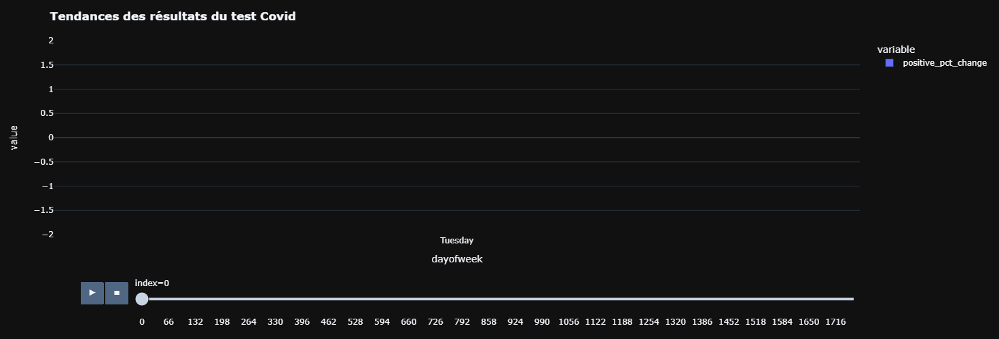

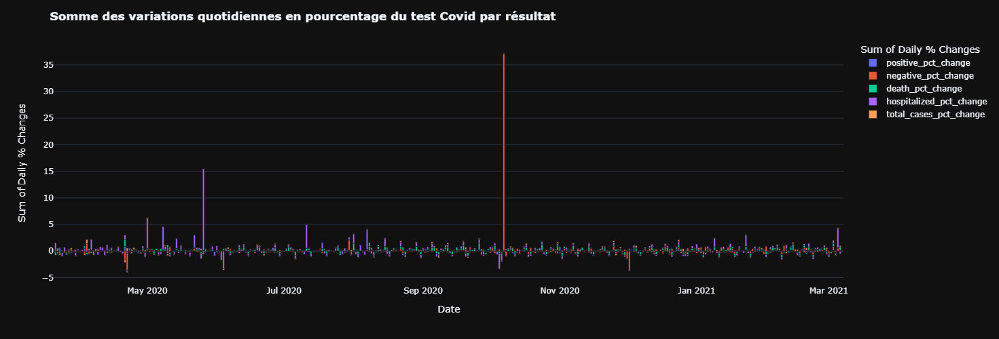

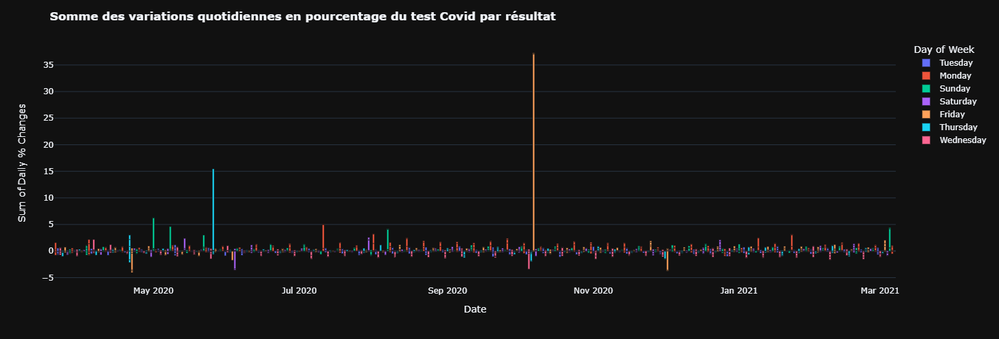

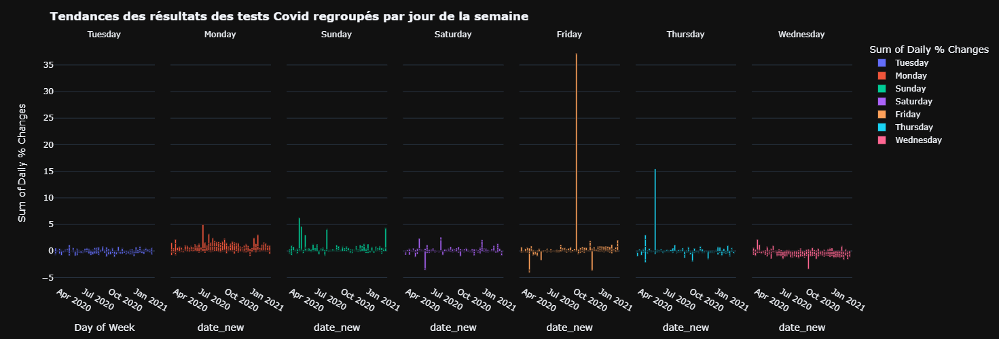

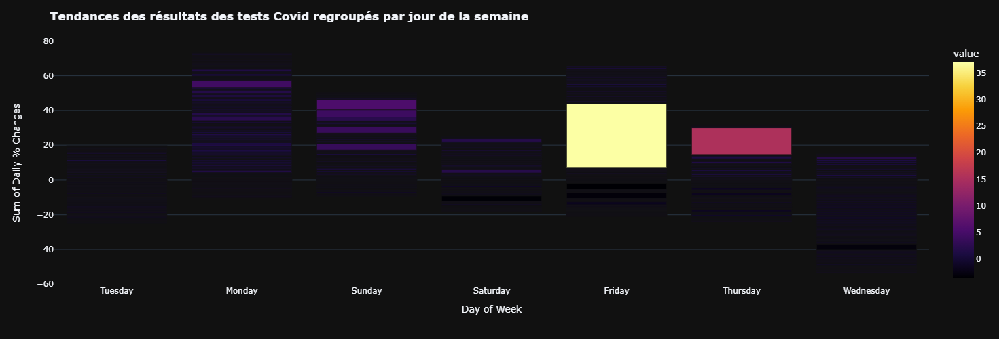

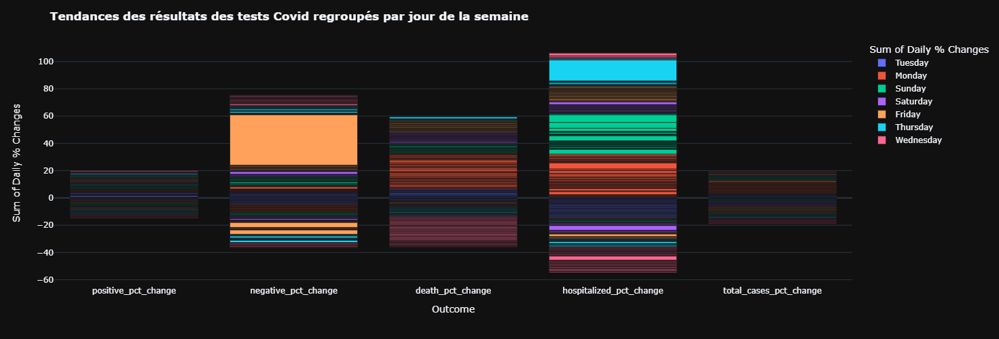

In [69]:
fig40 = px.bar(cases_melted
                 , x="dayofweek", y="value"
                 , color="variable"
                 , hover_name="value"
                 , range_y=[-2,2]
                 , animation_group="dayofweek"
                 , animation_frame=cases_melted.index)

fig40['layout'].update(height=500
                # , width=1200
                , title='<b>Tendances des résultats du test Covid</b>'
                , template='plotly_dark')
fig40.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig40.show()


fig25 = px.bar(cases_melted, x="date_new", y="value"
                 , color="variable"
                 , color_continuous_scale=px.colors.sequential.Inferno)

fig25['layout'].update(height=500
                     # , width=1200
                     , title='<b>Somme des variations quotidiennes en pourcentage du test Covid par résultat</b>'
                     , yaxis_title="Sum of Daily % Changes"
                     , xaxis_title="Date"
                     , legend_title="Sum of Daily % Changes"
                     , template='plotly_dark')
fig25.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig25.show()

fig26 = px.bar(cases_melted, x="date_new", y="value"
                 , color="dayofweek"
                 , color_continuous_scale=px.colors.sequential.Inferno)


fig26['layout'].update(height=500
                     # , width=1200
                     , title='<b>Somme des variations quotidiennes en pourcentage du test Covid par résultat</b>'
                     , yaxis_title="Sum of Daily % Changes"
                     , xaxis_title="Date"
                     , legend_title="Day of Week"
                     , template='plotly_dark')
fig26.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig26.show()

fig27 = px.bar(cases_melted, x="date_new", y="value"
                 , color="dayofweek", facet_col="dayofweek"
                 , color_continuous_scale=px.colors.sequential.Inferno)
#                  , facet_col_wrap=3)
#                  , size=cases_melted.index)

fig27['layout'].update(height=500
                     # , width=1200
                     , title='<b>Tendances des résultats des tests Covid regroupés par jour de la semaine</b>'
                     , template='plotly_dark'
                     , yaxis_title="Sum of Daily % Changes"
                     , xaxis_title="Day of Week"
                     , legend_title="Sum of Daily % Changes")
fig27.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig27.show()

fig28 = px.bar(cases_melted, x="dayofweek", y="value"
                 , color="value"
                 , color_continuous_scale=px.colors.sequential.Inferno)


fig28['layout'].update(height=500
                     # , width=1200
                     , title='<b>Tendances des résultats des tests Covid regroupés par jour de la semaine</b>'
                     , template='plotly_dark'
                     , yaxis_title="Sum of Daily % Changes"
                     , xaxis_title="Day of Week"
                     , legend_title="Sum of Daily % Changes")
fig28.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig28.show()

fig29 = px.bar(cases_melted, x="variable", y="value"
                 , color="dayofweek"
                 , color_continuous_scale=px.colors.sequential.Inferno)


fig29['layout'].update(height=500
                     # , width=1200
                     , title='<b>Tendances des résultats des tests Covid regroupés par jour de la semaine</b>'
                     , template='plotly_dark'
                     , yaxis_title="Sum of Daily % Changes"
                     , xaxis_title="Outcome"
                     , legend_title="Sum of Daily % Changes")
fig29.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig29.show()


In [70]:
#creation des colomn arondis
cases['total_rounded'] = cases.totalTestResultsIncrease.round(-4)
cases['percent_positive_rounded'] = cases.percent_positive.round(2)
cases['percent_negative_rounded'] = cases.percent_negative.round(2)
cases['percent_death_rounded'] = cases.percent_death.round(2)
cases['percent_hospitalized_rounded'] = cases.percent_hospitalized.round(2)

cases_rounded = cases[['date_new','total_rounded','percent_positive_rounded'
                      ,'percent_negative_rounded','percent_death_rounded'
                      ,'percent_hospitalized_rounded']]

#5 jour moyenne mobile
cases_rounded['percent_pos_5d_avg'] = cases_rounded.rolling(window=5)['percent_positive_rounded'].mean()
cases_rounded['total_rounded_5d_avg'] = cases_rounded.rolling(window=5)['total_rounded'].mean()
cases_rounded['percent_neg_5d_avg'] = cases_rounded.rolling(window=5)['percent_negative_rounded'].mean()
cases_rounded['percent_death_5d_avg'] = cases_rounded.rolling(window=5)['percent_death_rounded'].mean()
cases_rounded['percent_hospitalized_5d_avg'] = cases_rounded.rolling(window=5)['percent_hospitalized_rounded'].mean()

#colomn des pente
cases_rounded['percent_pos_5d_avg_slope'] = cases_rounded.percent_pos_5d_avg.diff().fillna(0)
cases_rounded['total_rounded_5d_avg_slope'] = cases_rounded.total_rounded_5d_avg.diff().fillna(0)
cases_rounded['percent_neg_5d_avg_slope'] = cases_rounded.percent_neg_5d_avg.diff().fillna(0)
cases_rounded['percent_death_5d_avg_slope'] = cases_rounded.percent_death_5d_avg.diff().fillna(0)
cases_rounded['percent_hospitalized_5d_avg_slope'] = cases_rounded.percent_hospitalized_5d_avg.diff().fillna(0)

#transformation en list
total_rounded = list(cases_rounded.total_rounded)
percent_positive_rounded = list(cases_rounded.percent_positive_rounded)
percent_negative_rounded = list(cases_rounded.percent_negative_rounded)
percent_death_rounded = list(cases_rounded.percent_death_rounded)
percent_hospitalized_rounded = list(cases_rounded.percent_hospitalized_rounded)


percent_pos_5d_avg = list(cases_rounded.percent_pos_5d_avg)
total_rounded_5d_avg = list(cases_rounded.total_rounded_5d_avg)
percent_neg_5d_avg = list(cases_rounded.percent_neg_5d_avg)
percent_death_5d_avg = list(cases_rounded.percent_death_5d_avg)
percent_hospitalized_5d_avg = list(cases_rounded.percent_hospitalized_5d_avg)

percent_pos_5d_avg_slope = list(cases_rounded.percent_pos_5d_avg_slope)
total_rounded_5d_avg_slope = list(cases_rounded.total_rounded_5d_avg_slope)
percent_neg_5d_avg_slope = list(cases_rounded.percent_neg_5d_avg_slope)
percent_death_5d_avg_slope = list(cases_rounded.percent_death_5d_avg_slope)
percent_hospitalized_5d_avg_slope = list(cases_rounded.percent_hospitalized_5d_avg_slope)

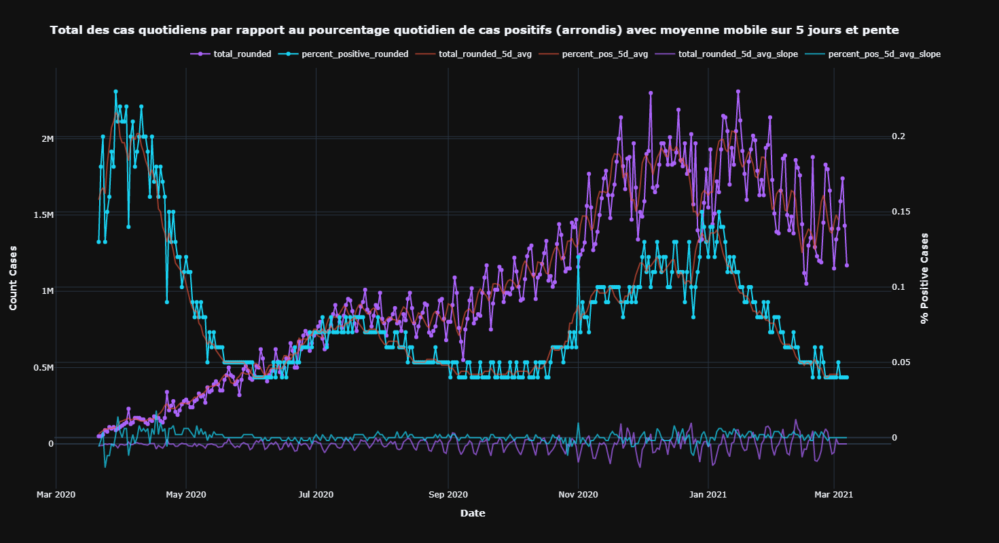

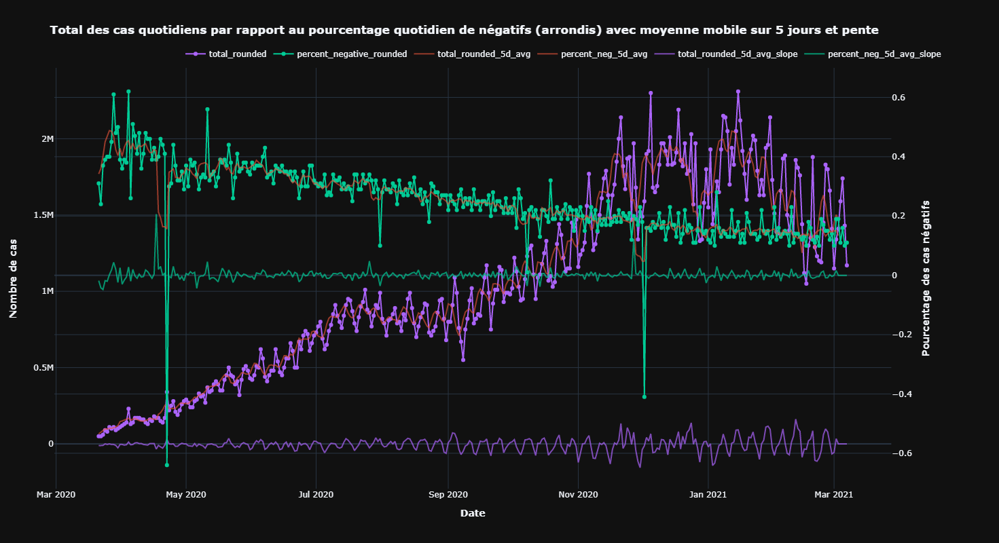

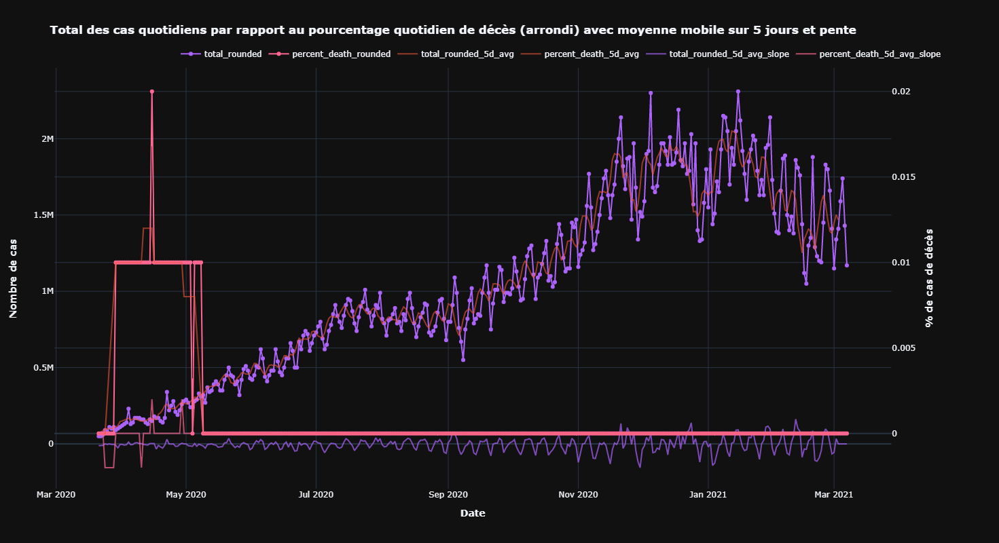

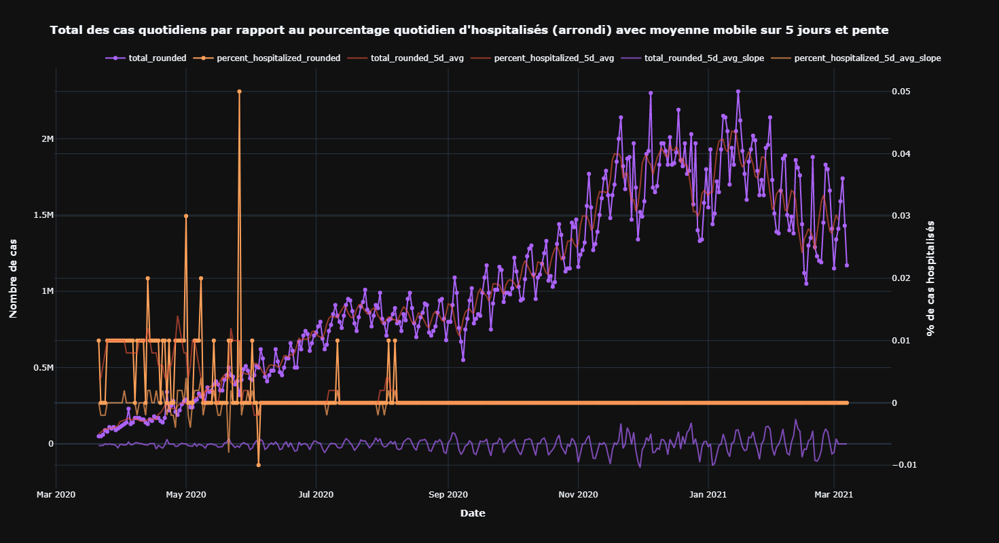

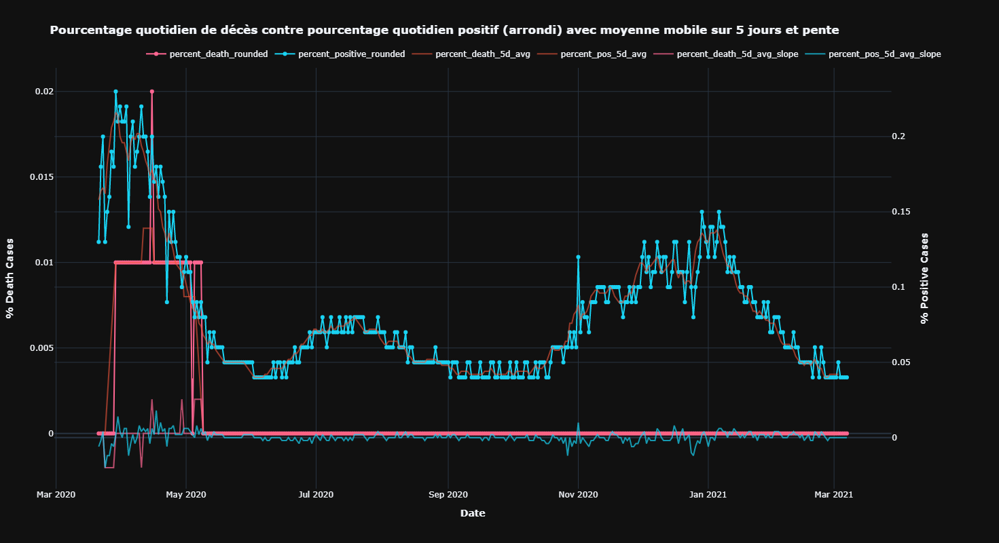

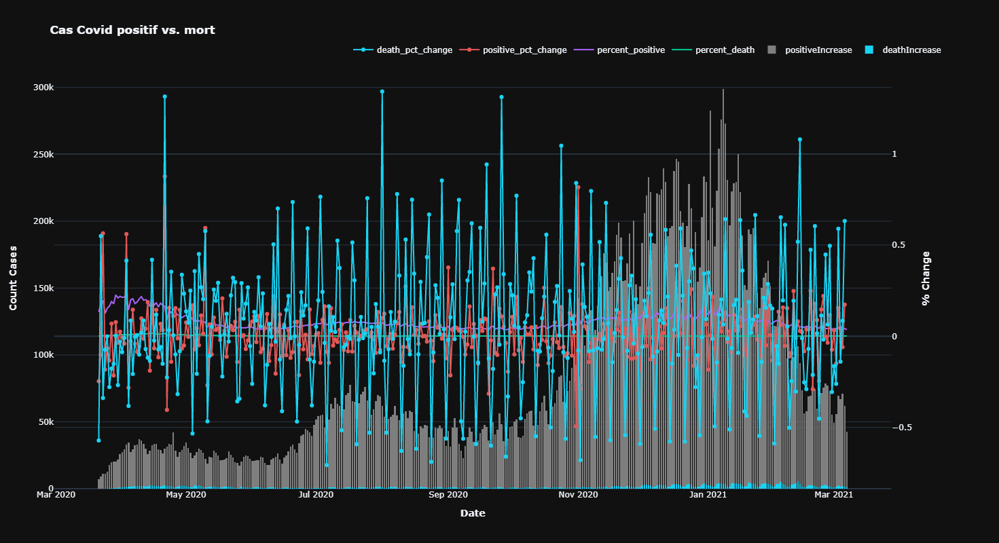

In [71]:
# le rest des graphs 

fig30 = make_subplots(specs=[[{"secondary_y": True}]])


fig30.add_trace(
    go.Scatter(x=date
           ,y=total_rounded
           ,name="total_rounded"
           ,mode="lines+markers"
#            ,opacity=.5
           ,marker_color=px.colors.qualitative.Plotly[3]),
    secondary_y=False,
)
fig30.add_trace(
    go.Scatter(x=date
           , y=percent_positive_rounded
#            , opacity=.5
           , mode="lines+markers"
           , marker_color=px.colors.qualitative.Plotly[5]
           , name="percent_positive_rounded"),
    secondary_y=True,
)

#moving averages
fig30.add_trace(
    go.Scatter(x=date
           , y=total_rounded_5d_avg
           , opacity=.6
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[1]
           , name="total_rounded_5d_avg"),
    secondary_y=False,
)
fig30.add_trace(
    go.Scatter(x=date
           , y=percent_pos_5d_avg
           , opacity=.6
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[1]
           , name="percent_pos_5d_avg"),
    secondary_y=True,
)


fig30.add_trace(
    go.Scatter(x=date
           , y=total_rounded_5d_avg_slope
           , opacity=.7
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[3]
           , name="total_rounded_5d_avg_slope"),
    secondary_y=False,
)
fig30.add_trace(
    go.Scatter(x=date
           , y=percent_pos_5d_avg_slope
           , opacity=.7
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[5]
           , name="percent_pos_5d_avg_slope"),
    secondary_y=True,
)


fig30.update_layout(
    title_text="<b>Total des cas quotidiens par rapport au pourcentage quotidien de cas positifs (arrondis) avec moyenne mobile sur 5 jours et pente</b>"
    ,height=800
)


fig30.update_xaxes(title_text="<b>Date</b>")


fig30.update_yaxes(title_text="<b>Count Cases</b>", secondary_y=False)
fig30.update_yaxes(title_text="<b>% Positive Cases</b>", secondary_y=True)


fig30.update_layout(barmode='stack')


fig30.update_traces(
#                   marker_color='rgb(158,202,225)'
#                   , marker_line_color='rgb(8,48,107)',
                  marker_line_width=.01)
#                   ,opacity=0.6)


fig30.update_layout(
    template='plotly_dark'
    ,legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.01,
    xanchor="right",
    x=1
))

fig30.show()

fig31 = make_subplots(specs=[[{"secondary_y": True}]])


fig31.add_trace(
    go.Scatter(x=date
           ,y=total_rounded
           ,name="total_rounded"
           ,mode="lines+markers"
#            ,opacity=.5
           ,marker_color=px.colors.qualitative.Plotly[3]),
    secondary_y=False,
)
fig31.add_trace(
    go.Scatter(x=date
           , y=percent_negative_rounded
#            , opacity=.5
           , mode="lines+markers"
           , marker_color=px.colors.qualitative.Plotly[2]
           , name="percent_negative_rounded"),
    secondary_y=True,
)


fig31.add_trace(
    go.Scatter(x=date
           , y=total_rounded_5d_avg
           , opacity=.6
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[1]
           , name="total_rounded_5d_avg"),
    secondary_y=False,
)
fig31.add_trace(
    go.Scatter(x=date
           , y=percent_neg_5d_avg
           , opacity=.6
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[1]
           , name="percent_neg_5d_avg"),
    secondary_y=True,
)


fig31.add_trace(
    go.Scatter(x=date
           , y=total_rounded_5d_avg_slope
           , opacity=.7
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[3]
           , name="total_rounded_5d_avg_slope"),
    secondary_y=False,
)
fig31.add_trace(
    go.Scatter(x=date
           , y=percent_neg_5d_avg_slope
           , opacity=.7
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[2]
           , name="percent_neg_5d_avg_slope"),
    secondary_y=True,
)

fig31.update_layout(
    title_text="<b>Total des cas quotidiens par rapport au pourcentage quotidien de négatifs (arrondis) avec moyenne mobile sur 5 jours et pente</b>"
    ,height=800
)


fig31.update_xaxes(title_text="<b>Date</b>")

fig31.update_yaxes(title_text="<b>Nombre de cas</b>", secondary_y=False)
fig31.update_yaxes(title_text="<b>Pourcentage des cas négatifs</b>", secondary_y=True)

fig31.update_layout(barmode='stack')


fig31.update_traces(

                  marker_line_width=.01)


fig31.update_layout(
    template='plotly_dark'
    ,legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.01,
    xanchor="right",
    x=1
))
fig31.show()

fig32 = make_subplots(specs=[[{"secondary_y": True}]])


fig32.add_trace(
    go.Scatter(x=date
           ,y=total_rounded
           ,name="total_rounded"
           ,mode="lines+markers"
#            ,opacity=.5
           ,marker_color=px.colors.qualitative.Plotly[3]),
    secondary_y=False,
)
fig32.add_trace(
    go.Scatter(x=date
           , y=percent_death_rounded
#            , opacity=.5
           , mode="lines+markers"
           , marker_color=px.colors.qualitative.Plotly[6]
           , name="percent_death_rounded"),
    secondary_y=True,
)

fig32.add_trace(
    go.Scatter(x=date
           , y=total_rounded_5d_avg
           , opacity=.6
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[1]
           , name="total_rounded_5d_avg"),
    secondary_y=False,
)
fig32.add_trace(
    go.Scatter(x=date
           , y=percent_death_5d_avg
           , opacity=.6
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[1]
           , name="percent_death_5d_avg"),
    secondary_y=True,
)

fig32.add_trace(
    go.Scatter(x=date
           , y=total_rounded_5d_avg_slope
           , opacity=.7
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[3]
           , name="total_rounded_5d_avg_slope"),
    secondary_y=False,
)
fig32.add_trace(
    go.Scatter(x=date
           , y=percent_death_5d_avg_slope
           , opacity=.7
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[6]
           , name="percent_death_5d_avg_slope"),
    secondary_y=True,
)

fig32.update_layout(
    title_text="<b>Total des cas quotidiens par rapport au pourcentage quotidien de décès (arrondi) avec moyenne mobile sur 5 jours et pente</b>"
    ,height=800
)


fig32.update_xaxes(title_text="<b>Date</b>")

fig32.update_yaxes(title_text="<b>Nombre de cas</b>", secondary_y=False)
fig32.update_yaxes(title_text="<b>% de cas de décès</b>", secondary_y=True)

fig32.update_layout(barmode='stack')

fig32.update_traces(

                  marker_line_width=.01)



fig32.update_layout(
    template='plotly_dark'
    ,legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.01,
    xanchor="right",
    x=1
))
fig32.show()

fig33 = make_subplots(specs=[[{"secondary_y": True}]])


fig33.add_trace(
    go.Scatter(x=date
           ,y=total_rounded
           ,name="total_rounded"
           ,mode="lines+markers"
#            ,opacity=.5
           ,marker_color=px.colors.qualitative.Plotly[3]),
    secondary_y=False,
)
fig33.add_trace(
    go.Scatter(x=date
           , y=percent_hospitalized_rounded
#            , opacity=.5
           , mode="lines+markers"
           , marker_color=px.colors.qualitative.Plotly[4]
           , name="percent_hospitalized_rounded"),
    secondary_y=True,
)


fig33.add_trace(
    go.Scatter(x=date
           , y=total_rounded_5d_avg
           , opacity=.6
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[1]
           , name="total_rounded_5d_avg"),
    secondary_y=False,
)
fig33.add_trace(
    go.Scatter(x=date
           , y=percent_hospitalized_5d_avg
           , opacity=.6
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[1]
           , name="percent_hospitalized_5d_avg"),
    secondary_y=True,
)


fig33.add_trace(
    go.Scatter(x=date
           , y=total_rounded_5d_avg_slope
           , opacity=.7
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[3]
           , name="total_rounded_5d_avg_slope"),
    secondary_y=False,
)
fig33.add_trace(
    go.Scatter(x=date
           , y=percent_hospitalized_5d_avg_slope
           , opacity=.7
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[4]
           , name="percent_hospitalized_5d_avg_slope"),
    secondary_y=True,
)

fig33.update_layout(
    title_text="<b>Total des cas quotidiens par rapport au pourcentage quotidien d'hospitalisés (arrondi) avec moyenne mobile sur 5 jours et pente</b>"
    ,height=800
)


fig33.update_xaxes(title_text="<b>Date</b>")

fig33.update_yaxes(title_text="<b>Nombre de cas</b>", secondary_y=False)
fig33.update_yaxes(title_text="<b>% de cas hospitalisés</b>", secondary_y=True)

fig33.update_layout(barmode='stack')

fig33.update_traces(

                  marker_line_width=.01)

fig33.update_layout(
    template='plotly_dark'
    ,legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.0,
    xanchor="right",
    x=1
))
fig33.show()
fig34 = make_subplots(specs=[[{"secondary_y": True}]])


fig34.add_trace(
    go.Scatter(x=date
           ,y=percent_death_rounded
           ,name="percent_death_rounded"
           ,mode="lines+markers"
#            ,opacity=.5
           ,marker_color=px.colors.qualitative.Plotly[6]),
    secondary_y=False,
)
fig34.add_trace(
    go.Scatter(x=date
           , y=percent_positive_rounded
#            , opacity=.5
           , mode="lines+markers"
           , marker_color=px.colors.qualitative.Plotly[5]
           , name="percent_positive_rounded"),
    secondary_y=True,
)


fig34.add_trace(
    go.Scatter(x=date
           , y=percent_death_5d_avg
           , opacity=.6
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[1]
           , name="percent_death_5d_avg"),
    secondary_y=False,
)
fig34.add_trace(
    go.Scatter(x=date
           , y=percent_pos_5d_avg
           , opacity=.6
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[1]
           , name="percent_pos_5d_avg"),
    secondary_y=True,
)


fig34.add_trace(
    go.Scatter(x=date
           , y=percent_death_5d_avg_slope
           , opacity=.7
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[6]
           , name="percent_death_5d_avg_slope"),
    secondary_y=False,
)
fig34.add_trace(
    go.Scatter(x=date
           , y=percent_pos_5d_avg_slope
           , opacity=.7
           , mode="lines"
           , marker_color=px.colors.qualitative.Plotly[5]
           , name="percent_pos_5d_avg_slope"),
    secondary_y=True,
)

fig34.update_layout(
    title_text="<b>Pourcentage quotidien de décès contre pourcentage quotidien positif (arrondi) avec moyenne mobile sur 5 jours et pente</b>"
    ,height=800
)

fig34.update_xaxes(title_text="<b>Date</b>")

fig34.update_yaxes(title_text="<b>% Death Cases</b>", secondary_y=False)
fig34.update_yaxes(title_text="<b>% Positive Cases</b>", secondary_y=True)

fig34.update_layout(barmode='stack')

fig34.update_traces(

                  marker_line_width=.01)

fig34.update_layout(
    template='plotly_dark'
    ,legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.01,
    xanchor="right",
    x=1
))
fig34.show()

fig35 = make_subplots(specs=[[{"secondary_y": True}]])

fig35.add_trace(
    go.Bar(x=date
           ,y=deathIncrease
           ,name="deathIncrease"
           ,marker_color=px.colors.qualitative.Plotly[5]),
    secondary_y=False,
)
fig35.add_trace(
    go.Bar(x=date
           , y=positiveIncrease
           , name="positiveIncrease"
           , marker_color=px.colors.qualitative.D3[7]),
    secondary_y=False,
)

fig35.add_trace(
    go.Scatter(x=date
               ,y=percent_death
               ,name="percent_death"
               ,marker_color=px.colors.qualitative.Plotly[2]),
    secondary_y=True,
)
fig35.add_trace(
    go.Scatter(x=date
               ,y=percent_positive
               ,name="percent_positive"
               ,marker_color=px.colors.qualitative.Plotly[3]),
    secondary_y=True,
)

fig35.add_trace(
    go.Scatter(x=date
               ,y=positive_pct_change
               ,name="positive_pct_change"
               ,mode="lines+markers"
               ,marker_color=px.colors.qualitative.T10[2]),
    secondary_y=True,
)
fig35.add_trace(
    go.Scatter(x=date
               ,y=death_pct_change
               ,name="death_pct_change"
               ,mode="lines+markers"
               ,marker_color=px.colors.qualitative.Plotly[5]),
    secondary_y=True,
)

fig35.update_layout(
    title_text="<b>Cas Covid positif vs. mort</b>"
    ,height=800
)

fig35.update_xaxes(title_text="<b>Date</b>")

fig35.update_yaxes(title_text="<b>Count Cases</b>", secondary_y=False)
fig35.update_yaxes(title_text="<b>% Change</b>", secondary_y=True)
fig35.update_layout(barmode='stack')
fig35.update_traces(
                  marker_line_width=.01)
fig35.update_layout(
    template='plotly_dark'
    ,legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))
fig35.show()

# prévisions 

In [72]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
from statsmodels.tsa.seasonal import STL
from scipy.stats import boxcox
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import kpss
from statsmodels.tsa.statespace.sarimax import SARIMAX
import pmdarima as pm
from sklearn.metrics import r2_score, mean_squared_error 
import warnings

In [73]:
warnings.filterwarnings("ignore")
confirmed_url='https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv'
deaths_url='https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv'
confirmed=pd.read_csv(confirmed_url)
deaths=pd.read_csv(deaths_url)
confirmed.drop(['Province/State','Country/Region','Lat','Long'],axis=1,inplace=True)#dropping useless columns
deaths.drop(['Province/State','Country/Region','Lat','Long'],axis=1,inplace=True)
confirmed.head()

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,...,8/17/21,8/18/21,8/19/21,8/20/21,8/21/21,8/22/21,8/23/21,8/24/21,8/25/21,8/26/21
0,0,0,0,0,0,0,0,0,0,0,...,152243,152363,152411,152448,152448,152448,152583,152660,152722,152822
1,0,0,0,0,0,0,0,0,0,0,...,136598,137075,137597,138132,138790,139324,139721,140521,141365,142253
2,0,0,0,0,0,0,0,0,0,0,...,188663,189384,190078,190656,191171,191583,192089,192626,193171,193674
3,0,0,0,0,0,0,0,0,0,0,...,14960,14976,14981,14988,14988,14988,15002,15003,15014,15016
4,0,0,0,0,0,0,0,0,0,0,...,44972,45175,45325,45583,45817,45945,46076,46340,46539,46726


In [74]:
cf_columns=list(confirmed.columns)
cf_columns.reverse()
indices=[i for i in range(len(cf_columns)-1, -1, -1)]
for i,col in zip(indices,cf_columns[: -1]):
    confirmed[col]-=confirmed.iloc[:, i-1]
for i,col in zip(indices,cf_columns[: -1]):
    deaths[col]-=deaths.iloc[:, i-1]

In [4]:
glob_conf=pd.DataFrame(confirmed.apply(np.sum),columns=['positiveIncrease'])
glob_death=pd.DataFrame(deaths.apply(np.sum),columns=['deathIncrease'])
df=pd.merge(glob_conf,glob_death,how='outer',left_index=True,right_index=True)
df.index= pd.to_datetime(df.index) 
df.head()

,positiveIncrease,deathIncrease
2020-01-22,557,17
2020-01-23,98,1
2020-01-24,286,8
2020-01-25,492,16
2020-01-26,685,14


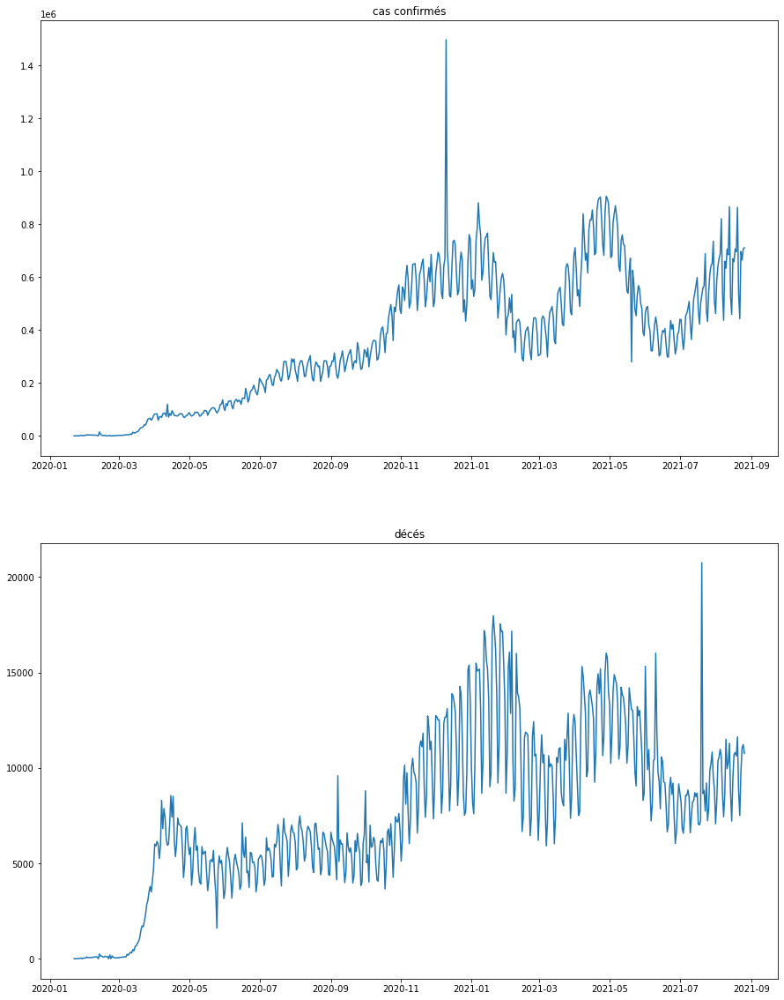

In [5]:
fig,axs=plt.subplots(figsize=(15,20), nrows=2)
axs[0].plot(df['positiveIncrease'])
axs[0].set_title('cas confirmés')
axs[1].plot(df['deathIncrease'])
axs[1].set_title('décés')
plt.show()

In [6]:
df_train=df.loc['2020-05-01':'2021-06-01']
df_test=df.loc['2021-06-01':]

### série des inféctions

#### stationarité

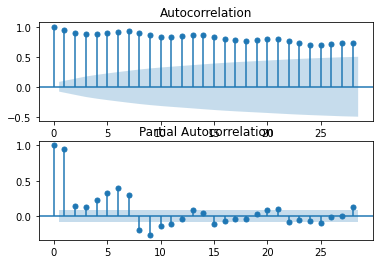

In [7]:
fig,axs=plt.subplots(2,1)
plot_acf(df['positiveIncrease'].values,ax=axs[0])
plot_pacf(df['positiveIncrease'].values,ax=axs[1])
plt.show()

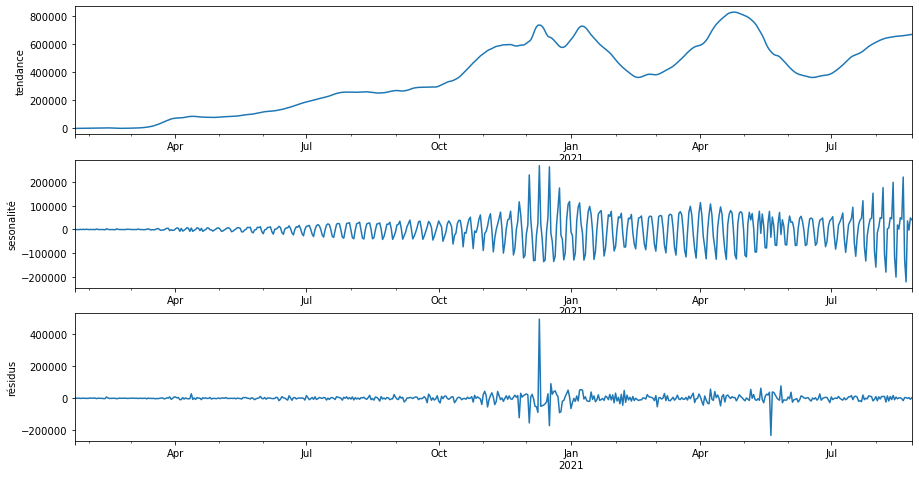

In [8]:
res=STL(df['positiveIncrease']).fit()
fig, (ax1,ax2,ax3) = plt.subplots(3,1, figsize=(15,8))
res.trend.plot(ax=ax1,ylabel = "tendance")
res.seasonal.plot(ax=ax2,ylabel = "sesonalité")
res.resid.plot(ax=ax3,ylabel = "résidus")
plt.show()

In [9]:
def kpss_test(timeseries, string):
    print (f'Resultats du test KPSS pour {string}')
    kpsstest = kpss(timeseries, regression='c', nlags="auto")
    kpss_output = pd.Series(kpsstest[0:3], index=['Test Statistic','p-value','Lags Used'])
    for key,value in kpsstest[3].items():
        kpss_output['valeur critique (%s)'%key] = value
    print (kpss_output)
kpss_test(df.positiveIncrease, 'les infections')

Resultats du test KPSS pour les infections
Test Statistic             2.66915
p-value                    0.01000
Lags Used                 16.00000
valeur critique (10%)      0.34700
valeur critique (5%)       0.46300
valeur critique (2.5%)     0.57400
valeur critique (1%)       0.73900
dtype: float64


p-value<0.05 donc on rejette l'hypothese nulle : càd la série n'est pas stationaire.
            on essaie de modéliser les deux séries avec des modéles (S)ARIMA(p,d,q).Cherchons donc les valeurs p,d et q

#### choix de d

In [10]:
df1=df.diff().dropna()
df2=df1.diff().dropna()

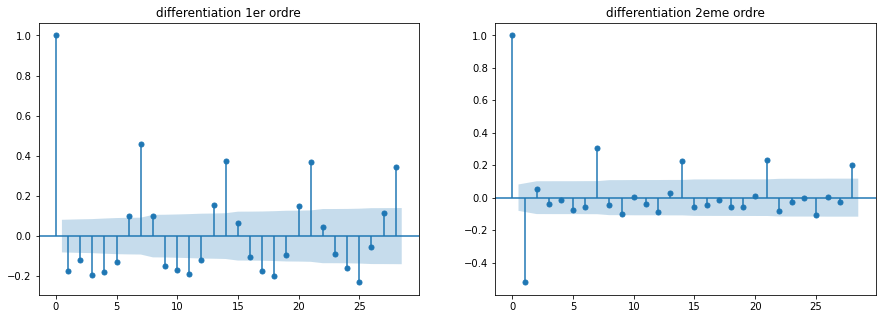

In [11]:
fig,axs=plt.subplots(1,2,figsize=(15,5))
plot_acf(df1['positiveIncrease'].values,ax=axs[0])
axs[0].set_title('differentiation 1er ordre')
plot_acf(df2['positiveIncrease'].values,ax=axs[1])
axs[1].set_title('differentiation 2eme ordre')
plt.show()

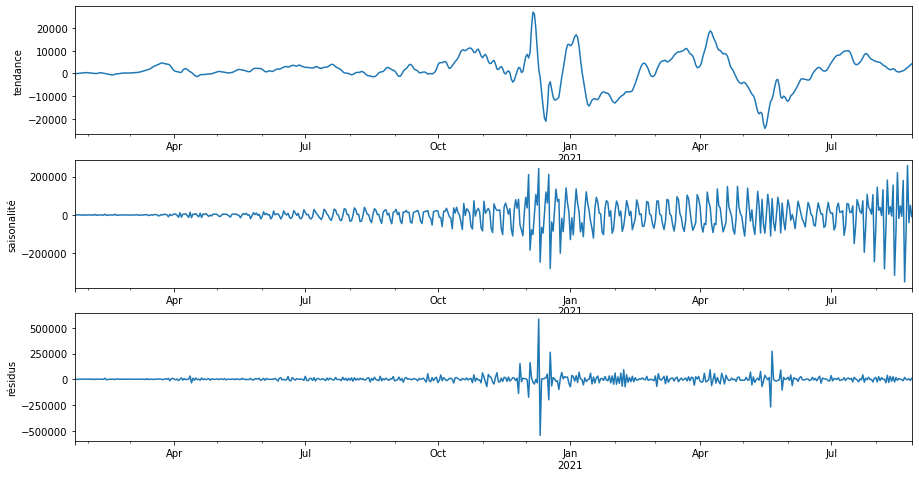

In [12]:
res=STL(df1['positiveIncrease']).fit()
fig, axs = plt.subplots(3,1, figsize=(15,8))
res.trend.plot(ax=axs[0],ylabel = "tendance")
res.seasonal.plot(ax=axs[1],ylabel = "saisonalité")
res.resid.plot(ax=axs[2],ylabel = "résidus")
plt.show()

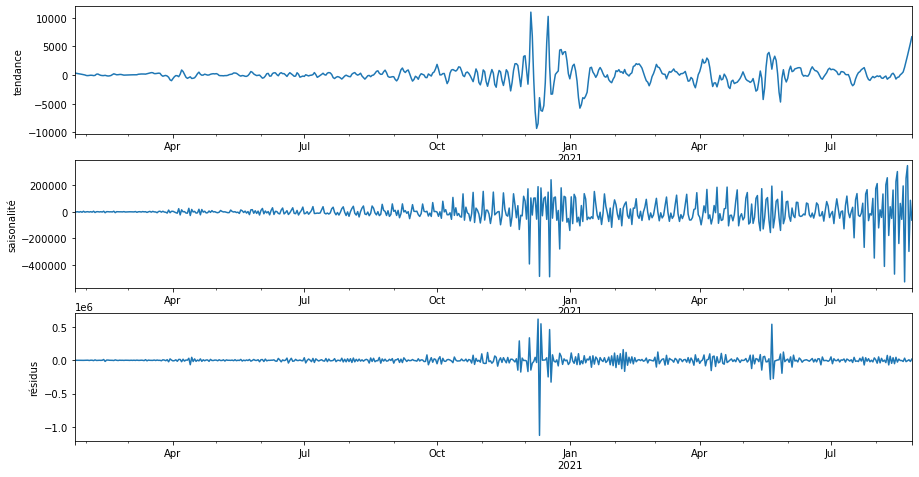

In [13]:
res=STL(df2['positiveIncrease']).fit()
fig, axs = plt.subplots(3,1, figsize=(15,8))
res.trend.plot(ax=axs[0],ylabel = "tendance")
res.seasonal.plot(ax=axs[1],ylabel = "saisonalité")
res.resid.plot(ax=axs[2],ylabel = "résidus")
plt.show()

In [14]:
kpss_test(df1.positiveIncrease, 'la differentiation du 1er ordre')
kpss_test(df2.positiveIncrease, 'la differentiation du 2eme ordre')

Resultats du test KPSS pour la differentiation du 1er ordre
Test Statistic             0.037825
p-value                    0.100000
Lags Used                 45.000000
valeur critique (10%)      0.347000
valeur critique (5%)       0.463000
valeur critique (2.5%)     0.574000
valeur critique (1%)       0.739000
dtype: float64
Resultats du test KPSS pour la differentiation du 2eme ordre
Test Statistic             0.071138
p-value                    0.100000
Lags Used                 85.000000
valeur critique (10%)      0.347000
valeur critique (5%)       0.463000
valeur critique (2.5%)     0.574000
valeur critique (1%)       0.739000
dtype: float64


les p-value sont supérieurs à 0.05 , donc selon le test kpss les deux différentiations sont stationaires. vu que la tendance n'est pas constante il semble mieux choisir l'ordre 2;mais puisqu'on utilisera une différentiation saisoniaire aussi on prend d=1. 

#### choix de p

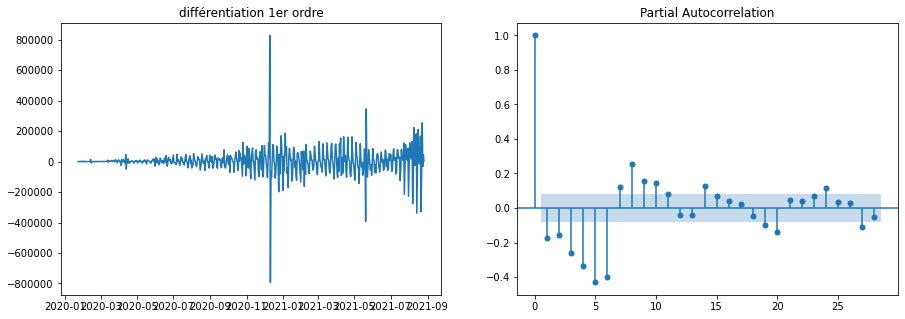

In [15]:
fig,axs=plt.subplots(1, 2, figsize=(15,5))
axs[0].plot(df1.positiveIncrease)
axs[0].set_title('différentiation 1er ordre')
plot_pacf(df1.positiveIncrease,ax=axs[1])
plt.show()

on prend p=3

### choix de q

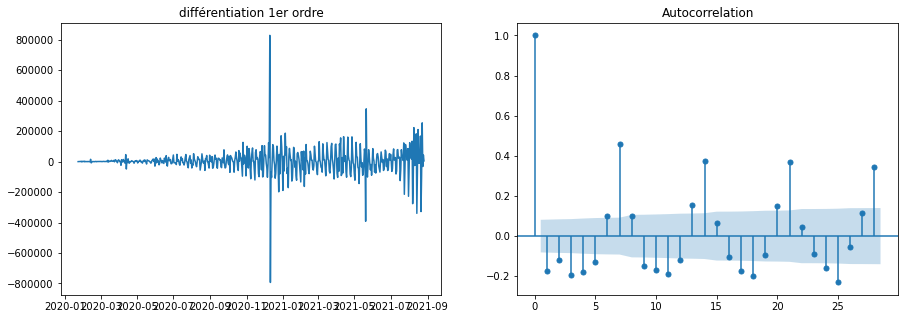

In [16]:
fig,axs=plt.subplots(1, 2, figsize=(15,5))
axs[0].plot(df1.positiveIncrease)
axs[0].set_title('différentiation 1er ordre')
plot_acf(df1.positiveIncrease,ax=axs[1])
plt.show()

on prend q=2,Q=1

## série des décés

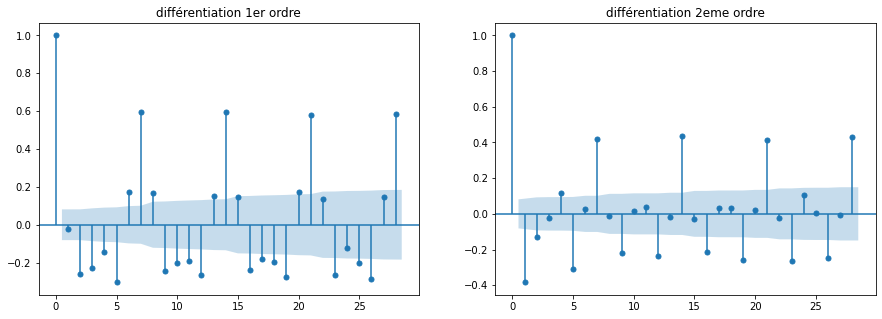

In [17]:
fig,axs=plt.subplots(1,2,figsize=(15,5))
plot_acf(df1['deathIncrease'].values,ax=axs[0])
axs[0].set_title('différentiation 1er ordre')
plot_acf(df2['deathIncrease'].values,ax=axs[1])
axs[1].set_title('différentiation 2eme ordre')
plt.show()

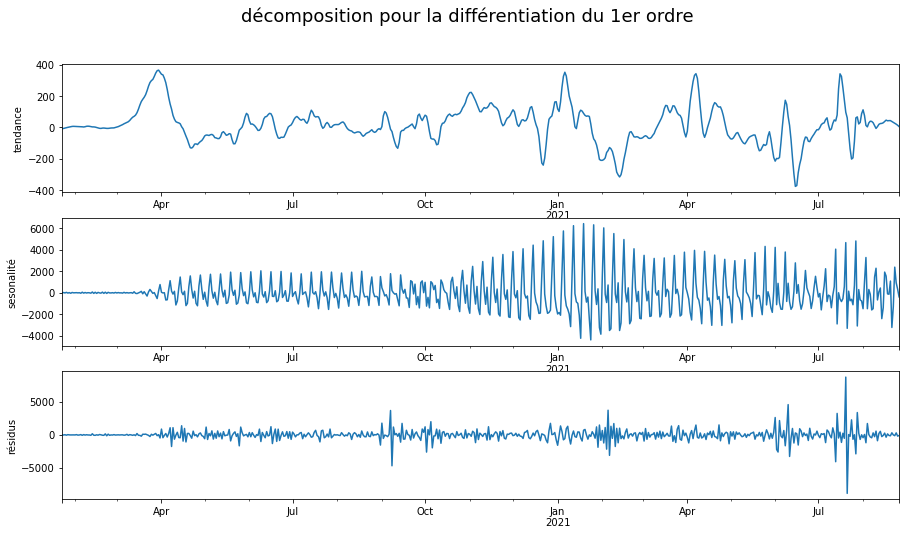

In [18]:
res=STL(df1['deathIncrease']).fit()
fig, (ax1,ax2,ax3) = plt.subplots(3,1, figsize=(15,8))
res.trend.plot(ax=ax1,ylabel = "tendance")
res.seasonal.plot(ax=ax2,ylabel = "sesonalité")
res.resid.plot(ax=ax3,ylabel = "résidus")
fig.suptitle('décomposition pour la différentiation du 1er ordre', fontsize=18)
plt.show()

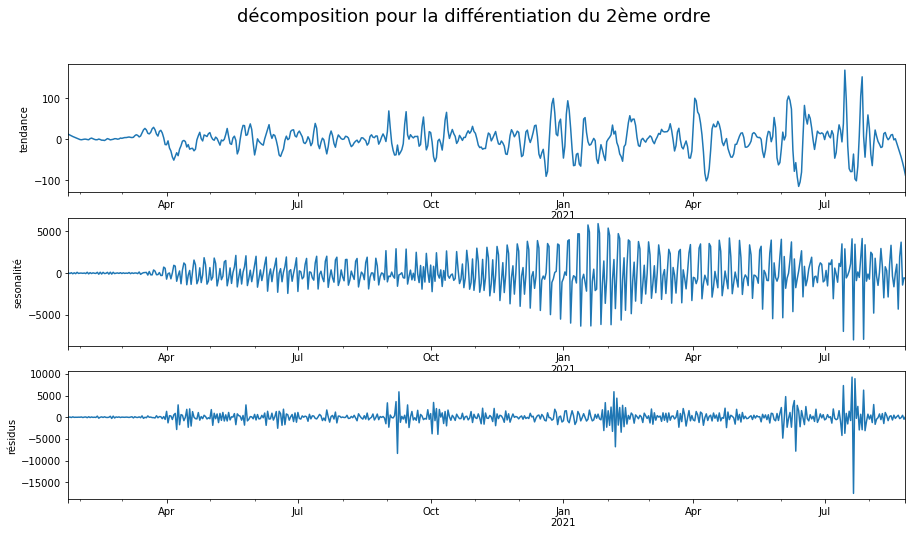

In [19]:
res=STL(df2['deathIncrease']).fit()
fig, (ax1,ax2,ax3) = plt.subplots(3,1, figsize=(15,8))
res.trend.plot(ax=ax1,ylabel = "tendance")
res.seasonal.plot(ax=ax2,ylabel = "sesonalité")
res.resid.plot(ax=ax3,ylabel = "résidus")
fig.suptitle('décomposition pour la différentiation du 2ème ordre', fontsize=18)
plt.show()

In [20]:
kpss_test(df1.deathIncrease, 'la différentiation du 1er ordre')
kpss_test(df2.deathIncrease, 'la différentiation du 2eme ordre')

Resultats du test KPSS pour la différentiation du 1er ordre
Test Statistic             0.108556
p-value                    0.100000
Lags Used                 48.000000
valeur critique (10%)      0.347000
valeur critique (5%)       0.463000
valeur critique (2.5%)     0.574000
valeur critique (1%)       0.739000
dtype: float64
Resultats du test KPSS pour la différentiation du 2eme ordre
Test Statistic             0.043637
p-value                    0.100000
Lags Used                 20.000000
valeur critique (10%)      0.347000
valeur critique (5%)       0.463000
valeur critique (2.5%)     0.574000
valeur critique (1%)       0.739000
dtype: float64


la méme remarque pour la série des inféctions :d=1 ,D=1

### choix de p

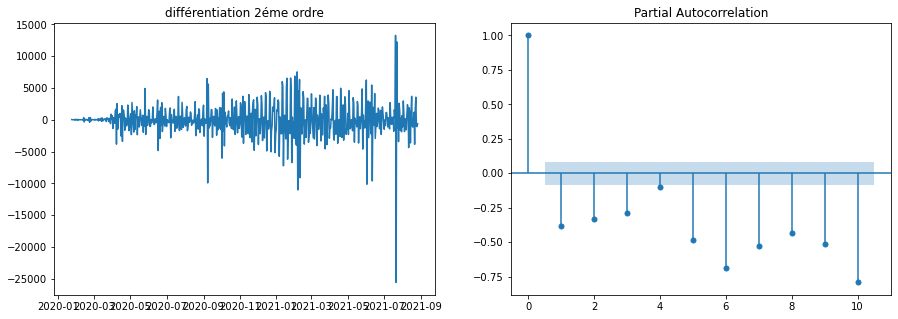

In [21]:
fig,axs=plt.subplots(1, 2, figsize=(15,5))
axs[0].plot(df2.deathIncrease)
axs[0].set_title('différentiation 2éme ordre')
plot_pacf(df2.deathIncrease,lags=10,ax=axs[1])
plt.show()

on prend p=3 et P=1

## les modéles

In [22]:
model=SARIMAX(endog=df_train.positiveIncrease, order=(3, 1, 2), seasonal_order=(0, 1, 1, 7))
res = model.fit()
print(res.summary())

                                      SARIMAX Results                                      
Dep. Variable:                    positiveIncrease   No. Observations:                  397
Model:             SARIMAX(3, 1, 2)x(0, 1, [1], 7)   Log Likelihood               -4861.049
Date:                             Fri, 27 Aug 2021   AIC                           9736.098
Time:                                     14:35:53   BIC                           9763.843
Sample:                                 05-01-2020   HQIC                          9747.097
                                      - 06-01-2021                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9414      0.089     10.562      0.000       0.767       1.116
ar.L2         -0.1698      

In [23]:
model1 = SARIMAX(endog=df_train.deathIncrease, order=(3, 1, 3), seasonal_order=(1, 1, 0, 7))
res1 = model1.fit()
print(res1.summary())

                                     SARIMAX Results                                      
Dep. Variable:                      deathIncrease   No. Observations:                  397
Model:             SARIMAX(3, 1, 3)x(1, 1, [], 7)   Log Likelihood               -3224.800
Date:                            Fri, 27 Aug 2021   AIC                           6465.601
Time:                                    14:35:54   BIC                           6497.309
Sample:                                05-01-2020   HQIC                          6478.171
                                     - 06-01-2021                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.5123      0.060    -25.025      0.000      -1.631      -1.394
ar.L2         -0.5516      0.114   

### recherche automatique du modèle

In [24]:
auto_model = pm.auto_arima(df_train.positiveIncrease, start_p=1, start_q=1,
                         test='adf',
                         max_p=3, max_q=3, m=7,
                         start_P=0, D=1, seasonal=True,
                         d=1, trace=True,
                         error_action='ignore',  
                         suppress_warnings=True, 
                         stepwise=False)
print(auto_model.summary())

 ARIMA(0,1,0)(0,1,0)[7]             : AIC=10052.686, Time=0.03 sec
 ARIMA(0,1,0)(0,1,1)[7]             : AIC=9875.016, Time=0.08 sec
 ARIMA(0,1,0)(0,1,2)[7]             : AIC=9883.631, Time=0.26 sec
 ARIMA(0,1,0)(1,1,0)[7]             : AIC=9956.295, Time=0.03 sec
 ARIMA(0,1,0)(1,1,1)[7]             : AIC=9870.345, Time=0.11 sec
 ARIMA(0,1,0)(1,1,2)[7]             : AIC=9866.344, Time=0.35 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=9904.898, Time=0.11 sec
 ARIMA(0,1,0)(2,1,1)[7]             : AIC=9864.721, Time=0.24 sec
 ARIMA(0,1,0)(2,1,2)[7]             : AIC=9865.565, Time=0.59 sec
 ARIMA(0,1,1)(0,1,0)[7]             : AIC=9864.511, Time=0.05 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=9753.635, Time=0.09 sec
 ARIMA(0,1,1)(0,1,2)[7]             : AIC=9752.425, Time=0.22 sec
 ARIMA(0,1,1)(1,1,0)[7]             : AIC=9809.774, Time=0.11 sec
 ARIMA(0,1,1)(1,1,1)[7]             : AIC=9752.689, Time=0.19 sec
 ARIMA(0,1,1)(1,1,2)[7]             : AIC=9754.197, Time=0.30 sec
 ARIMA(0,

In [25]:
auto_model1 = pm.auto_arima(df_train.deathIncrease, start_p=1, start_q=1,
                      test='adf',
                      max_p=3, max_q=3,
                      m=7, 
                      d=1,        
                      seasonal=True,   
                      start_P=0, 
                      D=1, 
                      trace=True,
                      error_action='ignore',  
                      suppress_warnings=True, 
                      stepwise=False)
print(auto_model1.summary())

 ARIMA(0,1,0)(0,1,0)[7]             : AIC=6701.688, Time=0.02 sec
 ARIMA(0,1,0)(0,1,1)[7]             : AIC=6549.334, Time=0.12 sec
 ARIMA(0,1,0)(0,1,2)[7]             : AIC=6550.986, Time=0.36 sec
 ARIMA(0,1,0)(1,1,0)[7]             : AIC=6609.281, Time=0.05 sec
 ARIMA(0,1,0)(1,1,1)[7]             : AIC=6550.955, Time=0.25 sec
 ARIMA(0,1,0)(1,1,2)[7]             : AIC=6550.753, Time=0.74 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=6588.402, Time=0.09 sec
 ARIMA(0,1,0)(2,1,1)[7]             : AIC=6552.642, Time=0.47 sec
 ARIMA(0,1,0)(2,1,2)[7]             : AIC=6548.476, Time=0.86 sec
 ARIMA(0,1,1)(0,1,0)[7]             : AIC=6558.274, Time=0.11 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=6454.740, Time=0.23 sec
 ARIMA(0,1,1)(0,1,2)[7]             : AIC=6454.541, Time=0.40 sec
 ARIMA(0,1,1)(1,1,0)[7]             : AIC=6491.762, Time=0.19 sec
 ARIMA(0,1,1)(1,1,1)[7]             : AIC=6454.082, Time=0.35 sec
 ARIMA(0,1,1)(1,1,2)[7]             : AIC=inf, Time=0.89 sec
 ARIMA(0,1,1)(2

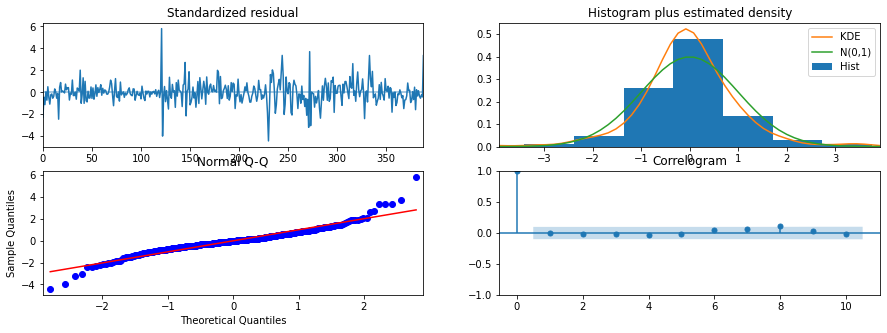

In [26]:
auto_model1.plot_diagnostics(figsize=(15,5))
plt.show()

les résidus semblent flucturer autour de la moyenne qui égale à 0 et ont une variance uniforme(constante).
le graphe de densité montre une distribution normale.
les points sont généralement alignés avec la ligne rouge , donc pas de déviation de distribution.
le correlogram (ACF) montrent que les résidus ne sont pas corrélés.

## prédiction et évaluation

on est intérésseé principalement par la prédiction des décés 

In [27]:
predictions=pd.DataFrame(auto_model1.predict(n_periods=len(df_test)),columns=['test'],index=df_test.index)

In [28]:
predictions

,test
2021-06-01,13681.182094
2021-06-02,13232.569014
2021-06-03,12193.004314
2021-06-04,11347.910222
2021-06-05,8726.795423
...,...
2021-08-22,7285.851145
2021-08-23,11919.953992
2021-08-24,11226.349191
2021-08-25,10934.483142


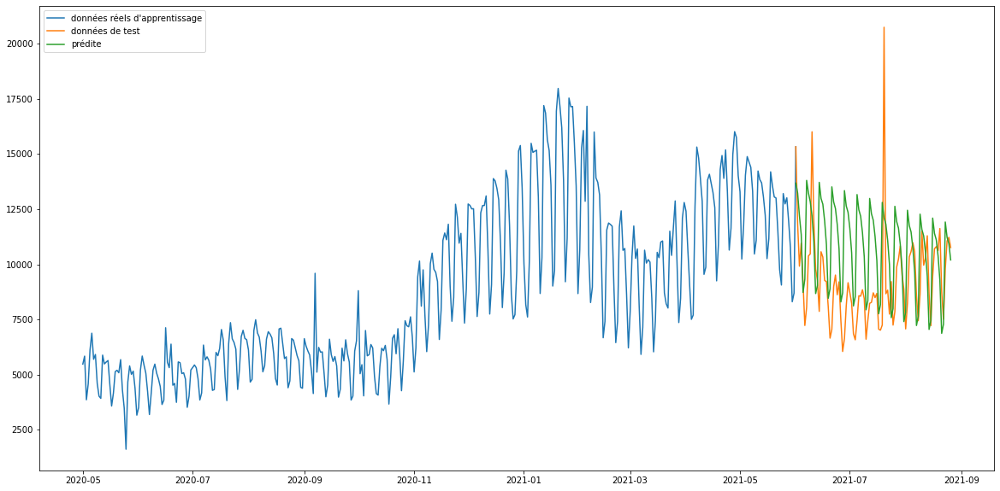

In [29]:
plt.figure(figsize=(20,10))
plt.plot(df_train.deathIncrease, label="données réels d'apprentissage")
plt.plot(df_test.deathIncrease, label="données de test")
plt.plot(predictions, label="prédite")
plt.legend(loc='upper left')
plt.show()

In [30]:
predictions=pd.DataFrame(auto_model1.predict(n_periods=33),columns=['prediction'],index=pd.date_range(start='6/1/2021', periods=33))

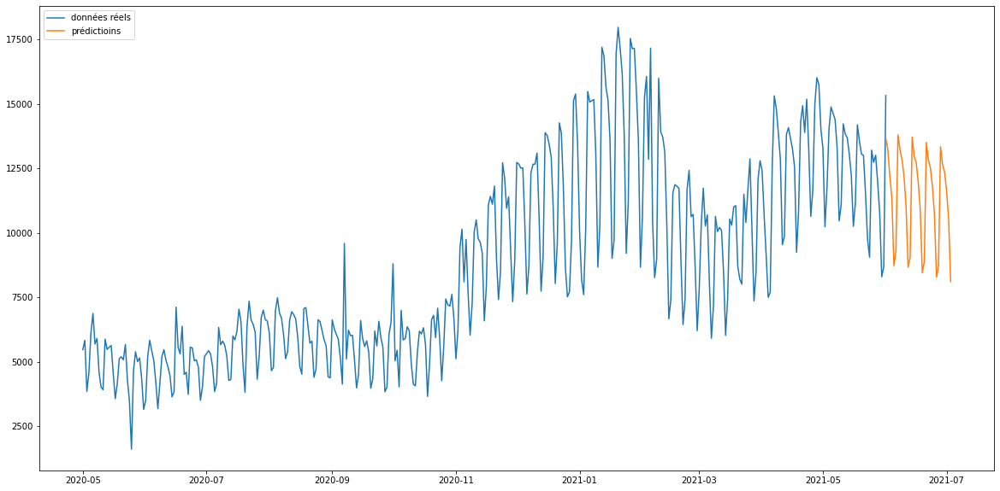

In [31]:
plt.figure(figsize=(20,10))
plt.plot(df_train.deathIncrease, label="données réels")
plt.plot(predictions, label='prédictioins')
plt.legend(loc='upper left')
plt.show()

In [32]:
predictions[12:]

,prediction
2021-06-13,9039.883296
2021-06-14,13717.461387
2021-06-15,12987.416398
2021-06-16,12726.093877
2021-06-17,11963.981619
2021-06-18,10886.331747
2021-06-19,8460.141132
2021-06-20,8892.640524
2021-06-21,13514.107057
2021-06-22,12831.093794


# dash app

In [ ]:
#import requests
import dash  # (version 1.12.0) pip install dash
import dash_table
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output, State

import pandas as pd
import plotly
import numpy as np
# import seaborn as sns

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import plotly.figure_factory as ff

import csv
from urllib.request import urlopen
import urllib.request

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.interpolate import interp1d
import plotly.graph_objects as go


bgcolors = {
    'background': '#CBC3E3',
    'text': '#FFFFFF'
}


external_scripts = [
    'https://www.google-analytics.com/analytics.js',
    {'src': 'https://cdn.polyfill.io/v2/polyfill.min.js'},
    {
        'src': 'https://cdnjs.cloudflare.com/ajax/libs/lodash.js/4.17.10/lodash.core.js',
        'integrity': 'sha256-Qqd/EfdABZUcAxjOkMi8eGEivtdTkh3b65xCZL4qAQA=',
        'crossorigin': 'anonymous'
    }
]


external_stylesheets = ['https://codepen.io/chriddyp/pen/bWLwgP.css']



app = dash.Dash(__name__,
                external_scripts=external_scripts
                ,external_stylesheets=external_stylesheets)


server = app.server


import os, ssl
if (not os.environ.get('PYTHONHTTPSVERIFY', '') and
getattr(ssl, '_create_unverified_context', None)):
    ssl._create_default_https_context = ssl._create_unverified_context


#-------------------------------------------------------------
#run app layout things

# app = dash.Dash()



app.layout = html.Div(children=[
        html.Br()
        ,html.Br()
        ,html.Br()

        ,html.H1(children=' analyze de la pandémie de covid')

        ,html.Div([
        html.H6(children='realiser par : youssef amine khallouq  ')
          
        ], style={"color": "#B2B7B7"})
     

        ,html.Br()
        ,html.Br()

        ,html.Div(children='''
        Le but de cette page est de fournir une analyse plus approfondie de\
        l'épidémie de Covid-19. Les graphiques de cette page offrent une gamme  \
        d'analyses.
        
        ''')

        ,html.Br()

        ,html.Div(children='''
        les données utiliser durant cette etude sont issue du '''),dcc.Markdown('''\
        [github]("https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series")''')
        ,html.Div(children='''
        la base de données concernant USA '''),dcc.Markdown('''\
        [Our World in Data]("https://covidtracking.com/api/v1/us/daily.csv")''')
   

        ,html.Br()

        ,html.Br()

    
        ,html.Br()
        ,html.Br()
        ,html.Br(),


  
    
    
    
    html.H1(children='statistiques générales')

        ,html.Div(children='''
        les graphiques ci-dessous représentent une vision générale des décès et des cas confirmés de covid-19 dans le monde, ainsi qu'une carte décrivant la propagation du covid-19. 
        ''')

        ,html.Br()

        ,html.H5(children='points à retenir:')

        ,html.Div(children='''
        on voit que le nombre des cas augmente légèrement avec la population , mais on trouve des pays qui font l'exception , les Etats-Unis par exemple a une population inférieure
        à celle de l'Inde pourtant elle a le plus grand nombre de cas. Pour avoir une vision plus clair, on compare le rapport : nombre de cas/population.
        ''')
        ,html.Br()

        ,html.Div(children='''
        on trouve ainsi que l'Inde a le quotient le plus petit alors qu'elle est la 2ème en terme de nombre de cas, cela vient du fait qu'elle a une grande population(la 2eme au monde)
        alors que le nombre de cas est relativement petit; de l'autre coté, les Etats-Unis, la France et l'Espagne sont les premiers dans de ce rapport puisque leurs nombre de cas est 
        relativement supérieur en comparaison avec leurs population.
        ''')
        ,html.Br()

        ,html.Div(children='''
        contrairement aux 10 premiers pays , les chiffres des pays les moins influencés ne montrent pas une corrélation entre le nombre de cas et la population, 
        cela peut être du aux manques des tests ou parce que les populations sont trop faibles et donc non-représentatives
        ''')

        ,html.Br()
    
         ,html.Div(children='''
        on remarque que les états-unis ont connut des hauts et bas dans leur journée covid , mais globalement leur nbre de cas augmente , pour l'Inde , 
        on trouve un point d'inflexion(dans le mois avril) suivi par une augmentation intense des cas , le Brazil avance toujours avec une pente élevée ,
        pour les autres pays ils avancent presque du méme comportement: une pente constante et relativement faible.
        ''')
        
        ,html.Br()

        ,html.Div(children='''
        on trouve l'evolution hebdomadaire a diminué dans les mémes periodes pour la plupart des pays , 2 période principalement : dès que le nombre des cas dépasse les 100 milles ,
        le nombbre de nouveaux cas par semaine diminue jusqu'à 500 cas , et l'orsque le nombre de cas dépasse 1.5 million le nbre de nouveaux cas par semaine se stabilse à 50k cas.
        Pourtant pour les états-unis,l'Inde et le Brazil : l'évolution hebdomadaire était toujours en augmentation. On remarque aussi que la France a connu une situation spéciale 
        pour nombre de cas envers 50k l'evolution hebdomadaire dans cette période était presque nulle.
        ''')
        

        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig101)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig102)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig103)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig104)
        ])

        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig55)
        ])
        
    
      

        ,html.Br()
        ,html.Br()
        ,html.Br()
        ,html.Br(),
        
        html.Iframe(srcDoc = open('C:\\Users\\youssef\\Desktop\\carteinitial.html', 'r').read(),style={"height": "1067px", "width": "100%"})
    
        ,html.Br()
        ,html.Br()
        ,html.Br()
        ,html.Br(),
    
      html.H1(children=' données des tests des états unis')

        ,html.Div(children='''
       d'après la partie précédente, les états-unis semblent avoir les taux de mortalité les plus élevés,
       et c'est l'un des rares pays qui ont une base de données complète et 
       détaillée des tests covid
       , donc nous avons décidé d'exploiter ces données qui concernent les états-unis.
        ''')
        ,html.Br()
        ,html.Br()
        ,html.Br(),
    
       html.Div([
        html.Div([
        html.H4("Cumule des  Tests"),
        dcc.Graph(figure=fig0)
        # ])
        ], className="six columns"
        ,style={'padding-left': '2%', 'padding-right': '2%',
                'vertical-align': 'middle'})

        ,html.Br(),

        html.Div([
        html.H4(" Tests "),
        dcc.Graph(figure=fig1)
        # ])
        ], className="six columns"
        ,style={'padding-left': '2%', 'padding-right': '2%',
                'margin-top': -24})

    ], className="row")
    
    
        ,html.Br()
        ,html.Br()
        ,html.Br()

        ,html.H2("Tests Covid quotidiens en fonction du Pourcentage Pos/Neg et  Pourcentage de changement quotidien")

        
        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig16)
        ])

        ,html.Br()
        ,html.Br()
        ,html.Br()
        ,html.Br()

        ,html.H1(children='Analyse du graphique ci-dessus')

        ,html.Div(children='''
        Les graphiques ci-dessous offrent une décomposition du graphique ci-dessus. Compte tenu de la complexité, on a décidé de proposer une vue pour chacune des pièces du graphique.
        ''')

        ,html.Br()

        ,html.H5(children=' points à retenir:')

        ,html.Div(children='''
        Plus il y a de tests quotidiens de covid, plus il y a de tests positifs.
        C'est simplement dans les chiffres. Ci-dessous, nous allons examiner les taux de mortalité
        pour répondre à la question : "Plus de tests covid égalent plus de décès dus au covid ?""
        ''')

        ,html.Br()

        ,html.Div(children='''
        En juillet, nous avons une moyenne d'environ 700 000 tests quotidiens de covid.
        ''')

        ,html.Br()

        
        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig2)
        ])
        # ], className="six columns"),

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig3)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig4)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig5)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig6)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig7)
        ])

        ,html.Br()
        ,html.Br()
        ,html.Br()
        ,html.Br(),

        html.H1(children='Tendances de distribution des résultats quotidiens')

        ,html.Div(children='''
        Les graphiques ci-dessous offrent une ventilation de chaque métrique du test covid (positif, 
        négatif, décès, hospitalisation). Il existe plusieurs façons de visualiser les éléments suivants 
        les graphiques - je propose quelques vues dans et autour des cartes thermiques, des diagrammes de dispersion avec des sous-points, 
        et des histogrammes.
        ''')

        ,html.Br()

        ,html.Div(children='''
        Les hauts et les bas de chaque marque sur les diagrammes de dispersion ci-dessous représentent les variations quotidiennes en pourcentage. 
        les variations quotidiennes en pourcentage ; ainsi, plus la marque est haute et plus elle est claire, plus le pourcentage de variation/augmentation par rapport au jour précédent est important. 
        de variation/augmentation en pourcentage par rapport à la journée précédente.
        ''')

        ,html.Br()

        ,html.H5(children=' points à retenir:')

        ,html.Div(children='''
        La majorité des pics ont eu lieu au début de l'épidémie de covid. 
         mois de mars et avril. Les variations quotidiennes en pourcentage 
        se sont aplatis pour la plupart dans chaque variable
        ''')

        ,html.Br()

       

        ,html.Br()

        
        ,html.Br()

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig8)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig9)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig10)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig11)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig12)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig13)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig14)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig15)
        ])

        ,html.Br()
        ,html.Br()
        ,html.Br()
        ,html.Br(),

        html.H1(children='Les mesures quotidiennes en fonction des  jours  de la semaine ')

        ,html.Div(children='''
        Les graphiques ci-dessous analysent les tendances au sein de jours spécifiques de la semaine 
        combinées à chaque métrique. Ainsi, nous pouvons répondre à des questions telles que 
        "quel jour de la semaine a vu le plus grand nombre de tests covid positifs" ou 
        "quel jour les gens sont plus susceptibles d'être hospitalisés à cause du covid-19"
        ''')

        ,html.Br()

        ,html.Div(children='''
       
        pour vous aider à mieux comprendre les tendances quotidiennes 

        ''')

        ,html.Br()

        ,html.H5(children=' points à retenir:')

        ,html.Div(children='''
        Le jour de la semaine où les tests sont les plus positifs est le mardi, suivi de près par le dimanche. 
        et le jour le moins positif est le vendredi.
        ''')

        ,html.Br()

        ,html.Div(children='''
        Les jours les plus négatifs sont aussi les mardis, tandis que les plus bas sont les vendredis.
        ''')

        ,html.Br()

        ,html.Div(children='''
        Cette conclusion est logique étant donné que les mardis et les vendredis sont respectivement les jours 
        les jours où les tests sont les plus élevés et les plus bas, respectivement.
        ''')

        ,html.Br()

        ,html.Div(children='''
        Les décès surviennent plus régulièrement les lundis et les dimanches, et sont moins susceptibles de se produire les jeudis et les vendredis. 
        de se produire les jeudis et les vendredis.
        ''')

        ,html.Br()

        ,html.Div(children='''
        Les hospitalisations ont lieu principalement les mardis et les samedis, et sont moins susceptibles 
        de tomber le jeudi.
        ''')

        ,html.Br()
        ,html.Br()

        
        ,html.Br()

        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig17)
        ])

        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig18)
        ])

        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig19)
        ])

        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig20)
        ])

        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig21)
        ])

        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig22)
        ])

        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig23)
        ])

        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig24)
        ])

        ,html.Br()
        ,html.Br()
        ,html.Br()
        ,html.Br()

        ,html.H1(children='Mesures historiques en fonction des Jours de la semaine et Totaux cumulatifs ')

        ,html.Div(children='''
        Les graphiques ci-dessous diffèrent des précédents en ce sens qu'ils analysent les métriques 
        au niveau quotidien - alors que la plupart des graphiques ci-dessus étaient regroupés par jour. 
        Les graphiques ci-dessous offrent une vue d'ensemble des pics de mesures par jour, ce qui permet de mieux comprendre les tendances hebdomadaires et mensuelles ainsi que les pics aberrants. 
        de mieux comprendre les tendances hebdomadaires et mensuelles ainsi que les pics aberrants.
        ''')

        ,html.Br()

        ,html.Div(children='''
        Les questions que l'on peut se poser sont les suivantes : 
        "Y a-t-il des jours précédents dans la semaine qui ont augmenté avec le temps ?", 
        "quels jours de la semaine sont plus/moins volatils ?",
        "Quelles sont les mesures qui ont les pics les plus élevés/les plus bas ?",
        "dans l'ensemble, quels sont les jours où la variation quotidienne en pourcentage est la plus faible/la plus forte ?" 
        ''')

        ,html.Br()

        ,html.H5(children=' points à retenir:')

        ,html.Div(children='''
        il apparaît que le nombre de pics a augmenté le mercredi, tandis que 
        Les mardis ont commencé avec un peu plus de pics, mais ont diminué.
        ''')
        ,html.Br()

        ,html.Div(children='''
        Le samedi a vu le pic le plus élevé dans les pourcentages de changement quotidiens, mais... 
        on peut se demander pourquoi. Le lundi a connu le pic le plus bas dans les variations quotidiennes en pourcentage.
        ''')
        ,html.Br()

        ,html.Div(children='''
        Les dimanches, vendredis et jeudis semblent avoir la même volatilité 
        lorsqu'il s'agit des variations quotidiennes cumulées en pourcentage.
        ''')
        ,html.Br()

        ,html.Div(children='''
        Les hospitalisations présentent le plus grand nombre de pics ainsi que les pics les plus élevé et le plus bas 
         globalement dans les variations quotidiennes cumulées en pourcentage.
        ''')
        ,html.Br()

        ,html.Div(children='''
        Les vendredis ont tendance à avoir les pics les plus bas dans les variations quotidiennes cumulées en pourcentage. 
        Plus de 50% des vendredis ont un pic négatif.
        ''')

        ,html.Br()
        ,html.Br()

        
        # ,html.Br()
        #
        # ,html.Div([
        # dcc.Graph(figure=fig40)
        # ])

        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig25)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig26)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig27)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig28)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig29)
        ])

        ,html.Br()
        ,html.Br()
        ,html.Br()
        ,html.Br(),

        html.H1(children='Moyenne mobile sur 5 jours des résultats obtenus en % des résultats quotidiens (arrondis)')

        ,html.Div(children='''
        Les graphiques ci-dessous offrent une vue plus analytique en comparant les pourcentages cumulés quotidiens arrondis de chaque mesure au total des tests quotidiens. 
        arrondis de chaque paramètre par rapport au total des tests quotidiens. on a également ajouté la pente 
        de chaque mesure par rapport au total des tests quotidiens, qui apparaît au bas de chaque graphique. 
        bas de chaque graphique. Les moyennes mobiles sur 5 jours sont arrondies pour lisser davantage les lignes (ce qui aide à montrer la pente). 
        les lignes (ce qui permet de mieux faire ressortir la pente). L'objectif de ces graphiques est de 
        de fournir une corrélation entre la métrique et le total des tests quotidiens.  et répondre a L'hypothèse 
        suivante : "plus il y a de tests, plus il y a de chaque métrique 

        ''')

        ,html.Br()

        ,html.Div(children='''
        Les questions que l'on peut se poser sont les suivantes : 
        "à quoi ressemblent les pentes de chaque mesure par rapport au total des tests quotidiens ?" 
        "Les pentes sont-elles corrélées au nombre total de tests quotidiens ? 
        ''')

        ,html.Br()

        ,html.H5(children=' points à retenir:')

        ,html.Div(children='''
        Les tests positifs et le total des tests quotidiens semblent très bien corrélés 
        à partir du mois de juin. L'augmentation des tests quotidiens s'avère être en corrélation directe avec le nombre de tests positifs. 
        corrélation directe avec le nombre de tests positifs ; 450 000 tests quotidiens équivalent à 
        environ 5 % de tests positifs par jour ; et donc 800 000 tests quotidiens équivalent à 
        environ 10 % de tests positifs.

        ''')
        ,html.Br()

        ,html.Div(children='''
        Les autres mesures ne semblent pas avoir de corrélation car les chiffres 
        sont tout simplement trop bas. Peut-être une analyse logarithmique pourrait aider
        ''')
        ,html.Br()

        ,html.Div(children='''
        Les vendredis ont tendance à avoir les pics les plus bas dans les variations quotidiennes cumulées en pourcentage. 
        Plus de 50% des vendredis ont un pic négatif.
        ''')

        ,html.Br()

        

        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig30)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig31)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig32)
        ])

        ,html.Br(),

        html.Div([
        dcc.Graph(figure=fig33)
        ])

        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig34)
        ])

        ,html.Br()
        ,html.Br()
        ,html.Br()
        ,html.Br()

        ,html.H1(children='Graphiques supplémentaires')

        ,html.Div(children='''
        Le graphique offrira des analyses supplémentaires, moins thématiques. 
        .
        ''')

        ,html.Br()

        ,html.Div(children='''
        Le  graph montre la corrélation entre les tests positifs quotidiens et les taux de mortalité quotidiens. 
        ainsi que les variations quotidiennes en pourcentage de chacune de ces mesures, 
        et le pourcentage de tests positifs pour la journée.
        ''')

        ,html.Br()

        ,html.H5(children=' points à retenir:')

        ,html.Div(children='''
        Les taux de mortalité diminuent aux États-Unis, malgré l'augmentation exponentielle 
        des tests quotidiens ainsi que du nombre de tests positifs. Il y a eu un petit 
        pic au début (pendant les mois d'avril et mai), mais ces chiffres ont diminué 
        de façon spectaculaire en juin et juillet. Il semble que nous ayons une légère 
        remontée vers la fin du mois de juillet.
        ''')

        ,html.Br()

        ,html.Div(children='''
        Les décès semblent atteindre un pic le dimanche et le lundi et diminuer au fil de la semaine. 
        Cela explique les pics de la ligne bleue (variation quotidienne du pourcentage de décès)..
        ''')

        ,html.Br()

        ,html.Div([
        dcc.Graph(figure=fig35)
        ])

        ,html.Br()
        ,html.Br()
        ,html.Br()

       
        

        ,html.Br()

],style={'padding-left': '20%'
        , 'padding-right': '20%'
        , 'backgroundColor':'white'}
        )



app.run_server(debug=True, use_reloader=False)  # Turn off reloader if inside Jupyter

if __name__ == '__main__':
    app.run_server(debug=True)

Dash is running on http://127.0.0.1:8050/

Dash is running on http://127.0.0.1:8050/

Dash is running on http://127.0.0.1:8050/

Dash is running on http://127.0.0.1:8050/

Dash is running on http://127.0.0.1:8050/

 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: on
